## Project Team ID : "PTID-CDS-JUL-23-1577"

# Team members
- Dhaya thilak bharathi p (dhayathilak96@gmail.com)
- Jeju (chinthaparthijeju123@gmail.com)

# Project ID: PRCL-0017 : No-Churn Telecom

### Business case:

### Import basic libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
import mysql.connector
import os

### Connection to the database

In [2]:
connection = mysql.connector.connect(host='18.136.157.135',user='dm_team3',password='DM!$!Team!27@9!20&')

In [3]:
query= 'show databases'

In [4]:
pd.read_sql_query(query,connection)

,Database
0,information_schema
1,project_telecom


In [5]:
connection1 = mysql.connector.connect(host='18.136.157.135',user='dm_team3',password='DM!$!Team!27@9!20&',database='project_telecom')

In [6]:
pd.read_sql_query('show tables',connection1)

,Tables_in_project_telecom
0,telecom_churn_data


In [7]:
data = pd.read_sql_query('select * from telecom_churn_data',connection1)

In [8]:
data

,columns1,columns2,columns3,columns4,columns5,columns6,columns7,columns8,columns9,columns10,...,columns12,columns13,columns14,columns15,columns16,columns17,columns18,columns19,columns20,columns21
0,KS,128,415,382-4657,no,yes,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10,3,2.7,1,False.
1,OH,107,415,371-7191,no,yes,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.7,1,False.
2,NJ,137,415,358-1921,no,no,0,243.4,114,41.38,...,110,10.3,162.6,104,7.32,12.2,5,3.29,0,False.
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.9,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False.
4,OK,75,415,330-6626,yes,no,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4612,NY,57,510,345-7512,no,yes,25,144,81,24.48,...,112,15.91,158.6,122,7.14,8.5,6,2.3,3,False.
4613,NM,177,408,343-6820,no,yes,29,189,91,32.13,...,96,25.76,163.6,116,7.36,15.7,1,4.24,3,False.
4614,VT,67,408,338-4794,no,yes,33,127.5,126,21.68,...,129,25.17,200.9,91,9.04,13,3,3.51,1,False.
4615,MI,98,415,355-8388,no,yes,23,168.9,98,28.71,...,117,19.24,165.5,96,7.45,14.3,3,3.86,0,False.


In [9]:
## Renaming of columns in data
cols={
    'columns1': 'State',
    'columns2': 'Account Length',
    'columns3': 'Area Code',
    'columns4': 'Phone',
    'columns5': 'International Plan',
    'columns6': 'VMail Plan',
    'columns7': 'VMail Message',
    'columns8': 'Day Mins',
    'columns9': 'Day Calls',
    'columns10': 'Day Charge',
    'columns11': 'Eve Mins',
    'columns12': 'Eve Calls',
    'columns13': 'Eve Charge',
    'columns14': 'Night Mins',
    'columns15': 'Night Calls',
    'columns16': 'Night Charge',
    'columns17': 'International Mins',
    'columns18': 'International calls',
    'columns19': 'International Charge',
    'columns20': 'CustServ Calls',
    'columns21': 'Churn'  
}

In [10]:
data.rename(columns=cols,inplace=True)

In [11]:
data

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,...,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
0,KS,128,415,382-4657,no,yes,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10,3,2.7,1,False.
1,OH,107,415,371-7191,no,yes,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.7,1,False.
2,NJ,137,415,358-1921,no,no,0,243.4,114,41.38,...,110,10.3,162.6,104,7.32,12.2,5,3.29,0,False.
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.9,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False.
4,OK,75,415,330-6626,yes,no,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4612,NY,57,510,345-7512,no,yes,25,144,81,24.48,...,112,15.91,158.6,122,7.14,8.5,6,2.3,3,False.
4613,NM,177,408,343-6820,no,yes,29,189,91,32.13,...,96,25.76,163.6,116,7.36,15.7,1,4.24,3,False.
4614,VT,67,408,338-4794,no,yes,33,127.5,126,21.68,...,129,25.17,200.9,91,9.04,13,3,3.51,1,False.
4615,MI,98,415,355-8388,no,yes,23,168.9,98,28.71,...,117,19.24,165.5,96,7.45,14.3,3,3.86,0,False.


## Domain analysis

- State: The state in which the customer has registered his mobile network
- AccountLength: The number of months the customer has stayed with the particular network
- AreaCode : Three digit area code coressponding to the customers phone no
- InternationalPlan: Whether the customer has InternationalPlan or not
- VMail plan: Whether the customer has voice mail feature
- Vmail Message: How many voice mail can the cutomer can send in a particular day
- DayMins: How many mins the user uses the network in a day
- DayCalls: How many calls the user has made in a particular day
- DayCharge: a charge payable by the service provider in a particular day
- Eve Mins: How many mins the customer uses the network in particular evening
- Eve calls: How many calls the customer has made in the particular evening
- Eve Charge: How much the customer is charged for a particular evening by the network provider
- Night mins: How many minutes the user spends time on the given network during night
- Night calls: How many calls is done by the user during night time
- Night charge: How is the customer charged by the network provider per night
- International mins: How many mins the cutomer spends on international calls
- International calls: How many international calls the customer has made in a day
- International Charge: How much is the customer charged per international call
- Custserv calls: How many cutomer service calls is received by the customer in a particular day
- Churn: The target column to be predicted on whether the cutomer changes his network or not

## Basic Checks

In [12]:
pd.set_option('display.max_columns',len(data))

In [13]:
# first 5 rows
data.head()

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
0,KS,128,415,382-4657,no,yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10,3,2.7,1,False.
1,OH,107,415,371-7191,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.7,1,False.
2,NJ,137,415,358-1921,no,no,0,243.4,114,41.38,121.2,110,10.3,162.6,104,7.32,12.2,5,3.29,0,False.
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.9,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False.
4,OK,75,415,330-6626,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False.


In [14]:
#last 5 rows

data.tail()

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
4612,NY,57,510,345-7512,no,yes,25,144,81,24.48,187.2,112,15.91,158.6,122,7.14,8.5,6,2.3,3,False.
4613,NM,177,408,343-6820,no,yes,29,189,91,32.13,303.1,96,25.76,163.6,116,7.36,15.7,1,4.24,3,False.
4614,VT,67,408,338-4794,no,yes,33,127.5,126,21.68,296.1,129,25.17,200.9,91,9.04,13,3,3.51,1,False.
4615,MI,98,415,355-8388,no,yes,23,168.9,98,28.71,226.3,117,19.24,165.5,96,7.45,14.3,3,3.86,0,False.
4616,IN,140,415,409-6884,no,no,0,204.7,100,34.8,126.8,107,10.78,202.8,115,9.13,12.1,4,3.27,2,False.


In [15]:
# memory usage
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4617 entries, 0 to 4616
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   State                 4617 non-null   object
 1   Account Length        4617 non-null   object
 2   Area Code             4617 non-null   object
 3   Phone                 4617 non-null   object
 4   International Plan    4617 non-null   object
 5   VMail Plan            4617 non-null   object
 6   VMail Message         4617 non-null   object
 7   Day Mins              4617 non-null   object
 8   Day Calls             4617 non-null   object
 9   Day Charge            4617 non-null   object
 10  Eve Mins              4617 non-null   object
 11  Eve Calls             4617 non-null   object
 12  Eve Charge            4617 non-null   object
 13  Night Mins            4617 non-null   object
 14  Night Calls           4617 non-null   object
 15  Night Charge          4617 non-null   

In [16]:
#statistical information
data.describe()

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
count,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617
unique,51,218,3,4617,2,2,47,1901,123,1901,1833,125,1621,1813,130,1012,168,21,168,10,2
top,WV,90,415,382-4657,no,no,0,154,102,26.18,169.9,105,14.25,194.3,105,9.66,9.8,3,2.65,1,False.
freq,149,63,2299,1,4171,3381,3381,10,108,10,10,111,15,10,115,19,81,925,81,1651,3961


In [17]:
# statistical info of categorical columns 
data.describe(include='O')

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
count,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617,4617
unique,51,218,3,4617,2,2,47,1901,123,1901,1833,125,1621,1813,130,1012,168,21,168,10,2
top,WV,90,415,382-4657,no,no,0,154,102,26.18,169.9,105,14.25,194.3,105,9.66,9.8,3,2.65,1,False.
freq,149,63,2299,1,4171,3381,3381,10,108,10,10,111,15,10,115,19,81,925,81,1651,3961


In [18]:
#check for duplicate values
data.duplicated().sum()

0

- There are no duplicate values in the given data

In [19]:
#check for null values
data.isnull().sum()

State                   0
Account Length          0
Area Code               0
Phone                   0
International Plan      0
VMail Plan              0
VMail Message           0
Day Mins                0
Day Calls               0
Day Charge              0
Eve Mins                0
Eve Calls               0
Eve Charge              0
Night Mins              0
Night Calls             0
Night Charge            0
International Mins      0
International calls     0
International Charge    0
CustServ Calls          0
Churn                   0
dtype: int64

- No null values in the given data

In [20]:
# check for datatypes
data.dtypes

State                   object
Account Length          object
Area Code               object
Phone                   object
International Plan      object
VMail Plan              object
VMail Message           object
Day Mins                object
Day Calls               object
Day Charge              object
Eve Mins                object
Eve Calls               object
Eve Charge              object
Night Mins              object
Night Calls             object
Night Charge            object
International Mins      object
International calls     object
International Charge    object
CustServ Calls          object
Churn                   object
dtype: object

### Coverting to the given Datatype

In [21]:
data[['Account Length','Area Code','VMail Message','Day Calls','Eve Calls',
      'Night Calls','International calls','CustServ Calls']]= data[['Account Length','Area Code',
'VMail Message','Day Calls','Eve Calls','Night Calls','International calls','CustServ Calls']].astype('int64')

In [22]:
data[['Day Mins','Day Charge','Eve Mins','Eve Charge','Night Mins',
      'Night Charge','International Mins','International Charge']]= data[['Day Mins','Day Charge','Eve Mins',
                'Eve Charge','Night Mins','Night Charge','International Mins','International Charge']].astype('float64')

In [23]:
data[['State','Phone','International Plan','VMail Plan']]= data[['State','Phone','International Plan','VMail Plan']].astype('object')

In [24]:
data.dtypes

State                    object
Account Length            int64
Area Code                 int64
Phone                    object
International Plan       object
VMail Plan               object
VMail Message             int64
Day Mins                float64
Day Calls                 int64
Day Charge              float64
Eve Mins                float64
Eve Calls                 int64
Eve Charge              float64
Night Mins              float64
Night Calls               int64
Night Charge            float64
International Mins      float64
International calls       int64
International Charge    float64
CustServ Calls            int64
Churn                    object
dtype: object

## Exploratory data analysis

### univariate

<Axes: xlabel='State', ylabel='count'>

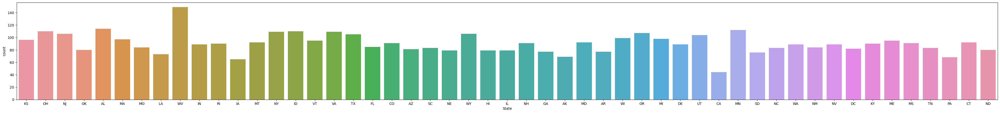

In [25]:
#State
plt.figure(figsize=(50,5))
sns.countplot(x=data.State)

- most of the customers are from the state wv(West virgia) state
- least no of customers are from ca(California)

<Axes: xlabel='International Plan', ylabel='count'>

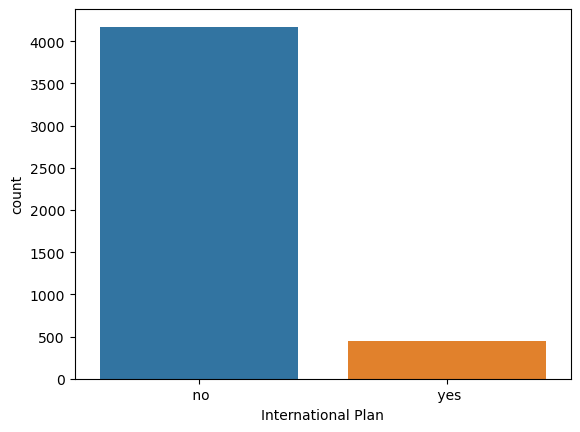

In [26]:
#International plan
sns.countplot(x=data['International Plan'])

- most of the customers do not have international plan
- very few customers have international plan active in their network

<Axes: xlabel='CustServ Calls', ylabel='count'>

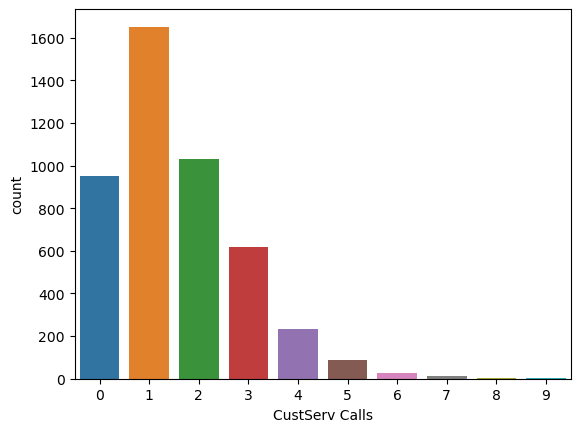

In [27]:
#cust serv calls
sns.countplot(x=data['CustServ Calls'])

- most of the cutomers recieve only 1 customer service call per day
- very few cutomers receive more than 5-9 cutomer calls per day

<Axes: xlabel='VMail Plan', ylabel='count'>

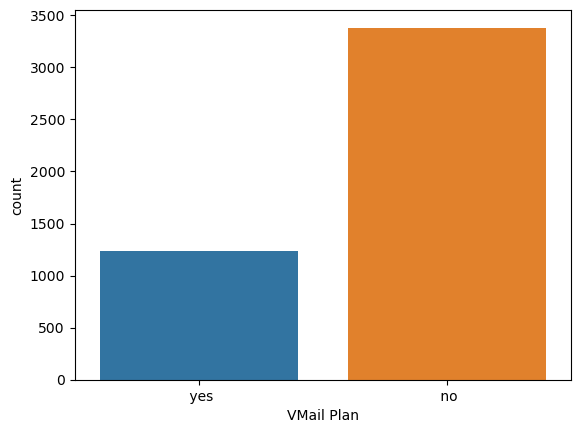

In [28]:
#VMail Plan
sns.countplot(x=data['VMail Plan'])

- Most of the customers do not have voicemail plan activated
- about 1200 customers have voice mail plan activated in their network

<Axes: xlabel='count', ylabel='Day Calls'>

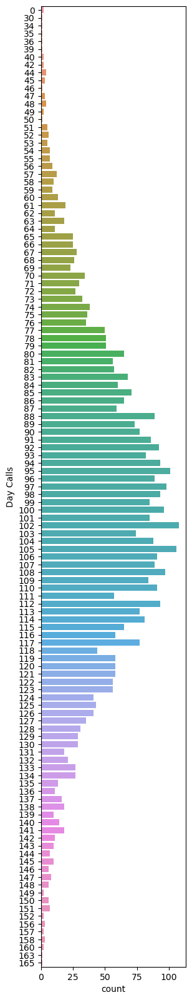

In [29]:
# Day calls
plt.figure(figsize=(3,20))
sns.countplot(y=data['Day Calls'])

- most of the customers made about 102 calls per day
- very few customers have made about 165 calls per day

## bivariate analysis

<Axes: xlabel='State', ylabel='CustServ Calls'>

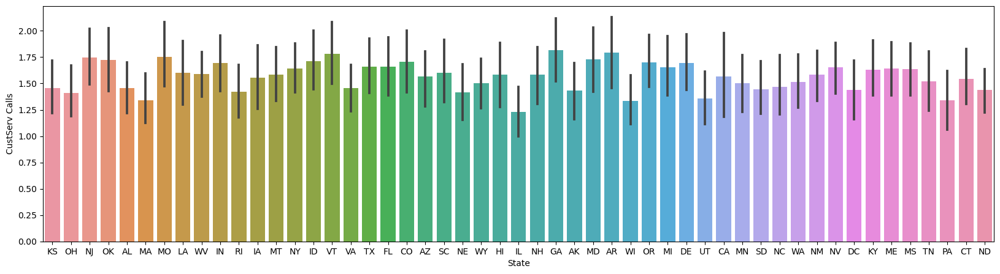

In [30]:
# Comparison between state and customer service calls
plt.figure(figsize=(20,5))
sns.barplot(y='CustServ Calls',x='State',data=data)

- The most frequent customer calls were recieved in Ga(Georgia) state
- IL(Illinois) state has received the least Customer service calls

<Axes: xlabel='State', ylabel='Count'>

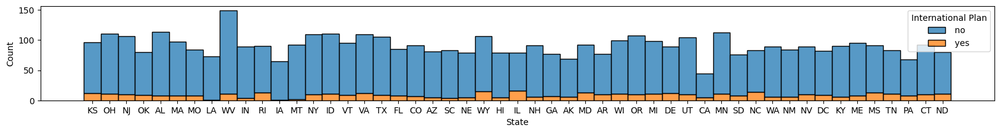

In [31]:
# comparison of state and international plan
plt.figure(figsize=(20,2))
sns.histplot(x='State',hue='International Plan',data=data,stat='count',multiple='stack')

- Rhode Island(RI) and Wyoming(WY) has most number of active international plans
- Canada(Ca),Arizona(AZ),south carolina(SC),Nebraska(Ne),New mexico(nm),Washington(wa),Kentucky(ky) has least number of active international plans

<Axes: xlabel='State', ylabel='Count'>

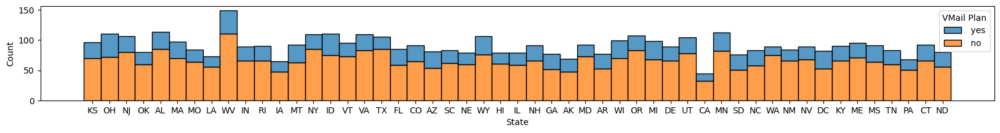

In [32]:
#compariosn of state and voice mail plan
plt.figure(figsize=(20,2))
sns.histplot(x='State',hue='VMail Plan',data=data,multiple='stack')

- West virgina(wv) has most customers having active voice mail plan
- Canada(CA) Has least customers having active voice mail plan

## Multivariate

In [33]:
# sns.pairplot(data)

## Data preprocessing

In [34]:
# check for null values
data.isnull().sum()

State                   0
Account Length          0
Area Code               0
Phone                   0
International Plan      0
VMail Plan              0
VMail Message           0
Day Mins                0
Day Calls               0
Day Charge              0
Eve Mins                0
Eve Calls               0
Eve Charge              0
Night Mins              0
Night Calls             0
Night Charge            0
International Mins      0
International calls     0
International Charge    0
CustServ Calls          0
Churn                   0
dtype: int64

- No null values in the data

In [35]:
# check for duplicate values
data.duplicated().sum()

0

In [36]:
#rows and columns
data.shape

(4617, 21)

- No duplicate values in the given data

In [37]:
#get only the numeric columns
numeric_data = data.select_dtypes(include='number')

In [38]:
#datatypes of dataframe
numeric_data.dtypes

Account Length            int64
Area Code                 int64
VMail Message             int64
Day Mins                float64
Day Calls                 int64
Day Charge              float64
Eve Mins                float64
Eve Calls                 int64
Eve Charge              float64
Night Mins              float64
Night Calls               int64
Night Charge            float64
International Mins      float64
International calls       int64
International Charge    float64
CustServ Calls            int64
dtype: object

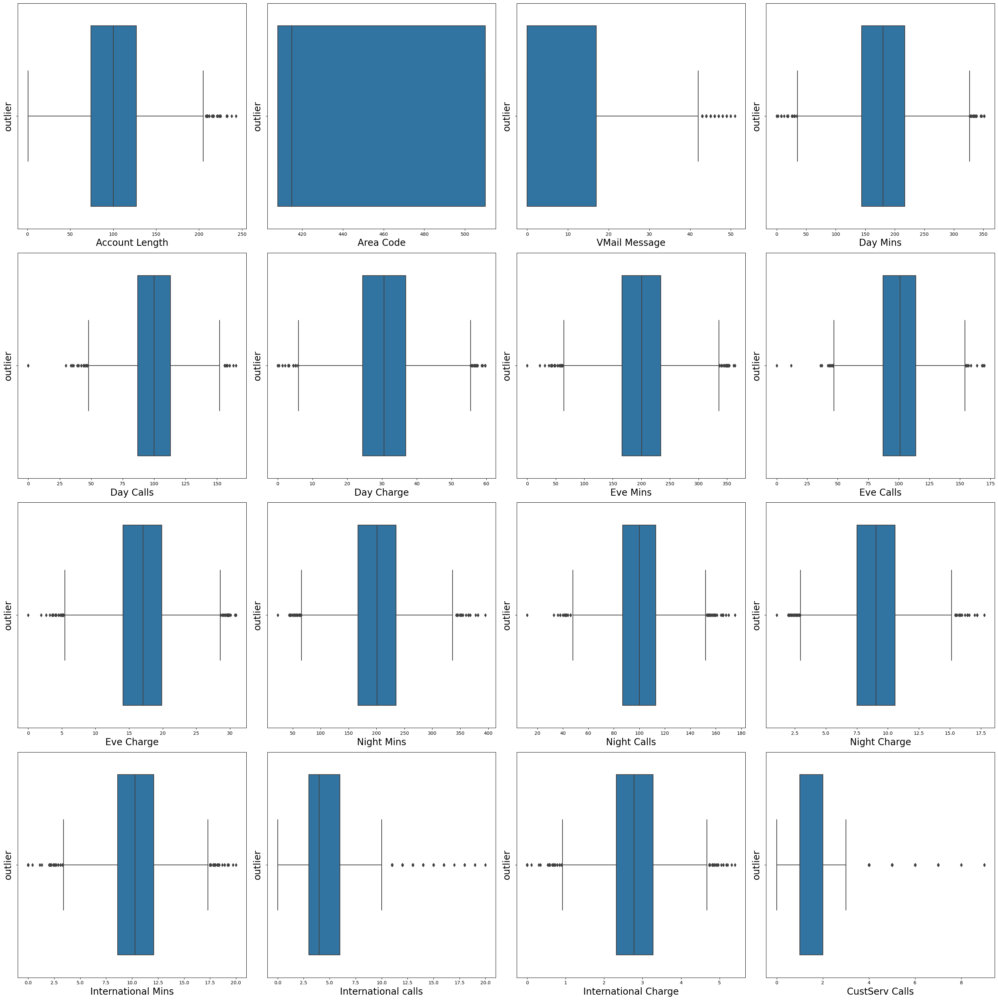

In [39]:
# check for outliers
plt.figure(figsize=(30,30),facecolor='white')
plotnumber=1
for cols in numeric_data:
    if plotnumber<=21:
        plt.subplot(4,4,plotnumber)
        sns.boxplot(x=numeric_data[cols])
        plt.xlabel(cols,fontsize=20)
        plt.ylabel('outlier',fontsize=20)
    plotnumber+=1
    
plt.tight_layout()

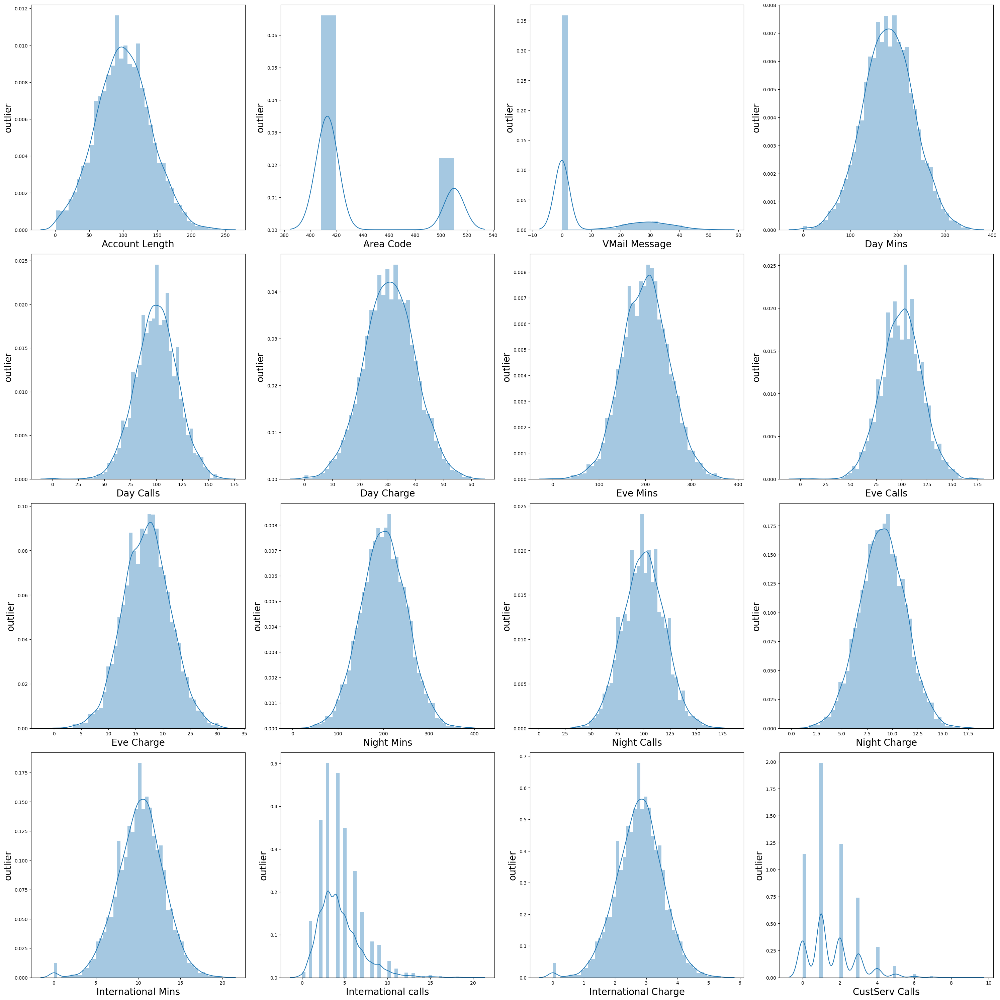

In [40]:
#check for distribution
plt.figure(figsize=(30,30),facecolor='white')
plotnumber=1
for cols in numeric_data:
    if plotnumber<=21:
        plt.subplot(4,4,plotnumber)
        sns.distplot(x=numeric_data[cols])
        plt.xlabel(cols,fontsize=20)
        plt.ylabel('outlier',fontsize=20)
    plotnumber+=1
    
plt.tight_layout()

In [41]:
#numeric columns
numeric_data.columns

Index(['Account Length', 'Area Code', 'VMail Message', 'Day Mins', 'Day Calls',
       'Day Charge', 'Eve Mins', 'Eve Calls', 'Eve Charge', 'Night Mins',
       'Night Calls', 'Night Charge', 'International Mins',
       'International calls', 'International Charge', 'CustServ Calls'],
      dtype='object')

### Account Length

In [42]:
print('Mean: ', data['Account Length'].mean())

Mean:  100.64522417153997


In [43]:
print('Median: ',data['Account Length'].median())

Median:  100.0


In [44]:
print('Mode: ',data['Account Length'].mode())

Mode:  0    90
Name: Account Length, dtype: int64


- The given data does not follow normal distribution hence we use Iqr method

In [45]:
## IQR
Q1= data['Account Length'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Account Length'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  74.0
Q3:  127.0
IQR : 53.0
Lower Limit:  -5.5
Upper limit:  206.5


In [46]:
data.loc[data['Account Length']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [47]:
data.loc[data['Account Length']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
197,TX,208,510,378-3625,no,no,0,326.5,67,55.51,176.3,113,14.99,181.7,102,8.18,10.7,6,2.89,2,True.
238,WY,215,510,393-9619,no,no,0,83.6,148,14.21,120.9,91,10.28,226.6,110,10.20,10.7,9,2.89,0,False.
309,SD,209,415,413-5310,no,no,0,227.2,128,38.62,258.4,92,21.96,183.5,74,8.26,8.9,4,2.40,3,False.
416,DE,224,510,361-6563,yes,no,0,171.5,99,29.16,160.0,103,13.60,212.4,102,9.56,5.0,2,1.35,1,True.
817,UT,243,510,355-9360,no,no,0,95.5,92,16.24,163.7,63,13.91,264.2,118,11.89,6.6,6,1.78,2,False.
1045,TX,217,408,385-7082,no,no,0,176.4,115,29.99,158.8,128,13.50,306.6,107,13.80,9.3,3,2.51,4,False.
1093,VA,210,408,360-8666,no,no,0,104.6,121,17.78,149.5,71,12.71,255.1,67,11.48,6.5,8,1.76,2,False.
1387,CT,212,415,366-6751,no,no,0,126.0,96,21.42,144.3,80,12.27,302.8,102,13.63,7.6,3,2.05,1,False.
1408,NM,232,408,386-9177,no,no,0,165.6,104,28.15,195.9,115,16.65,118.3,77,5.32,11.8,3,3.19,1,False.
1551,MI,225,415,371-2500,no,no,0,165.4,106,28.12,273.7,109,23.26,210.0,93,9.45,8.7,3,2.35,0,True.


In [48]:
data.loc[data['Account Length']>upper_limit].shape

(23, 21)

In [49]:
len(data.loc[data['Account Length']>upper_limit].shape)/4617*100

0.043318171973142736

- The outlier is below 5% hence we impute the values

In [50]:
data.loc[data['Account Length']>upper_limit,'Account Length']= data['Account Length'].median()

In [51]:
data.loc[data['Account Length']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### VMail Message

In [52]:
print('Mean: ', data['VMail Message'].mean())

Mean:  7.849902534113061


In [53]:
print('Median: ', data['VMail Message'].median())

Median:  0.0


In [54]:
print('Mode: ', data['VMail Message'].mode())

Mode:  0    0
Name: VMail Message, dtype: int64


- The given data is not normal hence we impute the values using IQR method

In [55]:
## IQR
Q1= data['VMail Message'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['VMail Message'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  0.0
Q3:  17.0
IQR : 17.0
Lower Limit:  -25.5
Upper limit:  42.5


In [56]:
data.loc[data['VMail Message']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [57]:
data.loc[data['VMail Message']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
71,MN,162,510,413-7170,no,yes,46,224.9,97,38.23,188.2,84,16.00,254.6,61,11.46,12.1,2,3.27,0,False.
149,RI,145,408,366-6730,no,yes,43,257.7,97,43.81,162.1,95,13.78,286.9,86,12.91,11.1,4,3.00,2,False.
268,MO,64,510,389-1475,no,yes,48,94.4,104,16.05,136.2,101,11.58,147.4,89,6.63,4.5,4,1.22,0,False.
277,SD,144,408,339-3049,no,yes,48,189.8,96,32.27,123.4,67,10.49,214.2,106,9.64,6.5,2,1.76,2,True.
423,IN,96,415,356-9187,no,yes,45,248.8,124,42.30,140.3,77,11.93,263.6,102,11.86,10.3,2,2.78,3,False.
599,OH,75,510,370-3021,no,yes,46,214.1,62,36.40,200.9,111,17.08,246.8,126,11.11,9.2,6,2.48,0,False.
615,UT,48,510,340-3075,no,yes,43,172.0,111,29.24,200.2,64,17.02,233.1,96,10.49,8.0,5,2.16,1,False.
790,AZ,92,415,416-9522,yes,yes,45,281.1,88,47.79,198.0,103,16.83,94.3,76,4.24,7.5,3,2.03,0,False.
845,FL,144,415,376-4484,no,yes,51,283.9,98,48.26,192.0,109,16.32,196.3,85,8.83,10.0,4,2.70,1,False.
872,OK,149,510,359-9972,no,yes,43,206.7,79,35.14,174.6,122,14.84,241.5,80,10.87,10.9,3,2.94,1,False.


In [58]:
data.loc[data['VMail Message']>upper_limit].shape

(51, 21)

In [59]:
len(data.loc[data['VMail Message']>upper_limit].shape)/4617*100

0.043318171973142736

- The outliers are below 5% hence we impute the values with median

In [60]:
data.loc[data['VMail Message']>upper_limit,'VMail Message']= data['VMail Message'].median()

In [61]:
data.loc[data['VMail Message']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### Day Mins

In [62]:
print('Mean: ', data['Day Mins'].mean())

Mean:  180.44715183019275


In [63]:
print('Mean: ', data['Day Mins'].median())

Mean:  180.0


In [64]:
print('Mean: ', data['Day Mins'].mode())

Mean:  0    154.0
1    189.3
Name: Day Mins, dtype: float64


- The column does not follow normal distribution hence we impute it with IQR

In [65]:
Q1= data['Day Mins'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Day Mins'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  143.7
Q3:  216.8
IQR : 73.10000000000002
Lower Limit:  34.049999999999955
Upper limit:  326.45000000000005


In [66]:
data.loc[data['Day Mins']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
685,CO,63,415,408-4530,no,yes,32,30.9,113,5.25,187.0,113,15.90,230.8,101,10.39,8.6,7,2.32,1,False.
741,NE,66,415,337-1225,no,no,0,34.0,133,5.78,278.6,61,23.68,129.6,120,5.83,11.5,3,3.11,0,False.
1052,OR,98,415,378-6772,yes,no,0,12.5,67,2.13,256.6,90,21.81,169.4,88,7.62,7.7,9,2.08,1,False.
1076,WY,53,415,337-4339,no,yes,27,25.9,119,4.40,206.5,96,17.55,228.1,64,10.26,6.5,7,1.76,1,False.
1345,SD,98,415,392-2555,no,no,0,0.0,0,0.00,159.6,130,13.57,167.1,88,7.52,6.8,1,1.84,4,True.
1397,VT,101,510,413-7655,no,no,0,0.0,0,0.00,192.1,119,16.33,168.8,95,7.60,7.2,4,1.94,1,False.
1621,SC,138,510,370-9533,no,yes,21,19.5,149,3.32,140.9,109,11.98,179.7,111,8.09,7.9,1,2.13,0,False.
1986,WI,70,415,405-9233,no,no,0,7.9,100,1.34,136.4,83,11.59,156.6,89,7.05,12.1,1,3.27,0,False.
2124,KS,43,415,381-9367,no,no,0,27.0,117,4.59,160.9,97,13.68,279.5,96,12.58,10.7,3,2.89,3,False.
2252,NH,148,408,333-7449,no,no,0,17.6,121,2.99,161.7,125,13.74,203.1,82,9.14,10.6,6,2.86,1,False.


In [67]:
data.loc[data['Day Mins']<lower_limit].shape

(14, 21)

In [68]:
len(data.loc[data['Day Mins']<lower_limit].shape)/4617*100

0.043318171973142736

In [69]:
data.loc[data['Day Mins']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,NY,161,415,351-7269,no,no,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,True.
156,OH,83,415,370-9116,no,no,0,337.4,120,57.36,227.4,116,19.33,153.9,114,6.93,15.8,7,4.27,0,True.
197,TX,100,510,378-3625,no,no,0,326.5,67,55.51,176.3,113,14.99,181.7,102,8.18,10.7,6,2.89,2,True.
365,CO,154,415,343-5709,no,no,0,350.8,75,59.64,216.5,94,18.40,253.9,100,11.43,10.1,9,2.73,1,True.
605,MO,112,415,373-2053,no,no,0,335.5,77,57.04,212.5,109,18.06,265.0,132,11.93,12.7,8,3.43,2,True.
975,DE,129,510,332-6181,no,no,0,334.3,118,56.83,192.1,104,16.33,191.0,83,8.59,10.4,6,2.81,0,True.
985,NY,64,415,345-9140,yes,no,0,346.8,55,58.96,249.5,79,21.21,275.4,102,12.39,13.3,9,3.59,1,True.
1679,OK,82,510,393-4823,no,no,0,329.8,73,56.07,208.3,120,17.71,267.1,102,12.02,10.6,6,2.86,0,True.
2028,SD,93,510,408-4836,no,no,0,328.1,106,55.78,151.7,89,12.89,303.5,114,13.66,8.7,3,2.35,1,True.
2594,OH,115,510,348-1163,yes,no,0,345.3,81,58.70,203.4,106,17.29,217.5,107,9.79,11.8,8,3.19,1,True.


In [70]:
data.loc[data['Day Mins']>upper_limit].shape

(13, 21)

In [71]:
len(data.loc[data['Day Mins']>upper_limit].shape)/4617*100

0.043318171973142736

- The outliers are below 5% hence we can impute the values for Day mins  column with median 

In [72]:
data.loc[data['Day Mins']>upper_limit]= data['Day Mins'].median()

In [73]:
data.loc[data['Day Mins']<lower_limit]= data['Day Mins'].median()

In [74]:
data.loc[data['Day Mins']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [75]:
data.loc[data['Day Mins']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### Day Calls

In [76]:
print('Mean: ', data['Day Calls'].mean())

Mean:  100.57764782326186


In [77]:
print('Median: ', data['Day Calls'].median())

Median:  100.0


In [78]:
print('Mode: ', data['Day Calls'].mode())

Mode:  0    102
Name: Day Calls, dtype: int64


- The given column does not follow normal distribution hence we impute the given values with IQR

In [79]:
Q1= data['Day Calls'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Day Calls'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  87.0
Q3:  114.0
IQR : 27.0
Lower Limit:  46.5
Upper limit:  154.5


In [80]:
data.loc[data['Day Calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
692,NE,82,408,343-2741,no,no,0,185.8,36,31.59,276.5,134,23.50,192.1,104,8.64,5.7,7,1.54,4,False.
740,UT,67,510,414-9027,no,yes,20,230.6,40,39.20,189.1,58,16.07,162.2,115,7.30,9.4,2,2.54,1,False.
1144,NH,155,408,353-6300,no,no,0,216.7,30,36.84,144.3,125,12.27,135.3,106,6.09,10.8,1,2.92,2,False.
1322,DE,2,415,415-8448,yes,no,0,132.1,42,22.46,138.9,88,11.81,192.6,119,8.67,9.1,1,2.46,2,True.
1346,PA,106,408,403-9167,yes,no,0,133.7,45,22.73,187.8,107,15.96,181.9,89,8.19,10.7,2,2.89,1,True.
1422,WY,107,510,411-5740,no,yes,31,160.3,45,27.25,221.5,70,18.83,261.6,109,11.77,5.6,1,1.51,1,False.
1989,MT,124,415,420-5652,no,yes,30,144.5,35,24.57,262.3,101,22.30,226.5,82,10.19,12.0,7,3.24,2,False.
2217,CA,137,415,415-3689,no,yes,22,189.6,42,32.23,179.0,137,15.22,179.6,126,8.08,11.4,5,3.08,2,False.
2492,SC,73,415,344-9347,no,no,0,203.3,45,34.56,141.9,87,12.06,200.7,71,9.03,8.5,6,2.30,0,False.
2884,UT,170,415,397-6542,no,no,0,285.7,44,48.57,167.5,144,14.24,260.0,97,11.70,8.7,4,2.35,1,True.


In [81]:
data.loc[data['Day Calls']<lower_limit].shape

(17, 21)

In [82]:
len(data.loc[data['Day Calls']<lower_limit].shape)/4617*100

0.043318171973142736

In [83]:
data.loc[data['Day Calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,180.0,180,180,180.0,180.0,180.0,180,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
156,180.0,180,180,180.0,180.0,180.0,180,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
197,180.0,180,180,180.0,180.0,180.0,180,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
315,MA,39,408,332-2462,no,no,0,60.4,158,10.27,306.2,120,26.03,123.9,46,5.58,12.4,3,3.35,1,False.
365,180.0,180,180,180.0,180.0,180.0,180,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
468,AZ,86,415,392-2381,no,yes,32,70.9,163,12.05,166.7,121,14.17,244.9,105,11.02,11.1,5,3.00,3,False.
605,180.0,180,180,180.0,180.0,180.0,180,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
685,180.0,180,180,180.0,180.0,180.0,180,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
741,180.0,180,180,180.0,180.0,180.0,180,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
975,180.0,180,180,180.0,180.0,180.0,180,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0


In [84]:
data.loc[data['Day Calls']>upper_limit].shape

(39, 21)

In [85]:
len(data.loc[data['Day Calls']>upper_limit].shape)/4617*100

0.043318171973142736

- The outliers for column Day Calls is below 5% hence we impute the values with median

In [86]:
data.loc[data['Day Calls']<lower_limit,'Day Calls']= data['Day Calls'].median()

In [87]:
data.loc[data['Day Calls']>upper_limit,'Day Calls']= data['Day Calls'].median()

In [88]:
data.loc[data['Day Calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [89]:
data.loc[data['Day Calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### Day Charge

In [90]:
print('Mean: ', data['Day Charge'].mean())

Mean:  31.55894736842105


In [91]:
print('Median: ', data['Day Charge'].median())

Median:  30.69


In [92]:
print('Mode: ', data['Day Charge'].mode())

Mode:  0    180.0
Name: Day Charge, dtype: float64


- The given columns does not follow normal distribution hence we impute the values with IQR

In [93]:
Q1= data['Day Charge'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Day Charge'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  24.51
Q3:  36.92
IQR : 12.41
Lower Limit:  5.895
Upper limit:  55.535000000000004


In [94]:
data.loc[data['Day Charge']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [95]:
data.loc[data['Day Charge']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0
156,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0
197,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0
365,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0
605,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0
685,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0
741,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0
975,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0
985,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0
1052,180.0,180,180,180.0,180.0,180.0,180,180.0,100,180.0,180.0,180,180.0,180.0,180,180.0,180.0,180,180.0,180,180.0


In [96]:
data.loc[data['Day Charge']>upper_limit].shape

(27, 21)

In [97]:
len(data.loc[data['Day Charge']>upper_limit].shape)/4617*100

0.043318171973142736

- The outliers are below 5% hence we impute the values with median

In [98]:
data.loc[data['Day Charge']>upper_limit,'Day Charge']= data['Day Charge'].median()

In [99]:
data.loc[data['Day Charge']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### Eve Mins

In [100]:
print('Mean: ', data['Eve Mins'].mean())

Mean:  200.30322720381199


In [101]:
print('Median: ', data['Eve Mins'].median())

Median:  200.5


In [102]:
print('Mode: ', data['Eve Mins'].mode())

Mode:  0    180.0
Name: Eve Mins, dtype: float64


- The given column does not follow normal distribution hence we impute the values with IQR

In [103]:
Q1= data['Eve Mins'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Eve Mins'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  166.2
Q3:  233.8
IQR : 67.60000000000002
Lower Limit:  64.79999999999995
Upper limit:  335.20000000000005


In [104]:
data.loc[data['Eve Mins']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False.
32,LA,172,408,383-1121,no,no,0,212.0,121,36.04,31.2,115,2.65,293.3,78,13.20,12.6,10,3.40,3,False.
186,NY,106,408,422-1471,no,no,0,158.7,74,26.98,64.3,139,5.47,198.5,103,8.93,10.2,4,2.75,1,False.
533,OK,125,415,406-5059,no,yes,36,201.3,117,34.22,42.2,78,3.59,125.7,104,5.66,5.4,3,1.46,1,False.
587,NH,114,415,406-4588,no,no,0,169.6,85,28.83,58.9,86,5.01,179.3,124,8.07,7.4,8,2.00,1,False.
821,MN,80,415,332-2137,no,no,0,105.8,110,17.99,43.9,88,3.73,189.6,87,8.53,13.1,5,3.54,0,False.
850,WA,166,408,354-9492,no,no,0,274.3,110,46.63,52.9,109,4.50,246.1,119,11.07,10.9,5,2.94,0,False.
889,MN,103,415,386-9141,no,no,0,198.5,112,33.75,42.5,90,3.61,179.2,124,8.06,12.4,5,3.35,0,False.
893,MO,167,415,397-8772,yes,no,0,244.8,91,41.62,60.8,105,5.17,176.7,110,7.95,10.7,3,2.89,2,False.
1054,AK,50,408,362-8331,no,no,0,183.6,107,31.21,58.6,118,4.98,202.6,99,9.12,8.7,3,2.35,1,False.


In [105]:
data.loc[data['Eve Mins']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
6,MA,121,510,355-9993,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,False.
8,LA,117,408,335-4719,no,no,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,False.
302,RI,121,408,329-7347,no,no,0,170.4,108,28.97,350.5,68,29.79,297.0,87,13.37,11.2,3,3.02,0,True.
529,DC,100,510,403-2455,yes,no,0,68.5,110,11.65,337.1,115,28.65,205.2,99,9.23,12.1,9,3.27,0,False.
580,IN,113,415,353-6007,no,no,0,209.4,151,35.60,347.3,113,29.52,246.0,116,11.07,7.4,2,2.00,1,True.
1276,MI,51,415,373-1448,no,no,0,229.7,129,39.05,336.0,104,28.56,192.8,128,8.68,9.6,1,2.59,1,True.
1601,AR,99,510,387-2604,yes,no,0,242.3,102,41.19,350.9,102,29.83,163.1,93,7.34,11.3,3,3.05,0,True.
2160,NV,94,408,351-4025,yes,no,0,89.5,94,15.22,339.9,106,28.89,172.9,76,7.78,7.9,1,2.13,1,True.
2331,IN,46,415,368-9751,no,yes,34,191.4,102,32.54,361.8,96,30.75,147.5,132,6.64,7.2,2,1.94,1,False.
2337,MD,139,415,335-3133,no,no,0,181.6,119,30.87,335.7,118,28.53,149.8,64,6.74,8.3,6,2.24,4,False.


In [106]:
data.loc[data['Eve Mins']<lower_limit].shape

(21, 21)

In [107]:
data.loc[data['Eve Mins']>upper_limit].shape

(18, 21)

In [108]:
len(data.loc[data['Eve Mins']>upper_limit].shape)/4617*100

0.043318171973142736

In [109]:
len(data.loc[data['Eve Mins']<lower_limit].shape)/4617*100

0.043318171973142736

- The given values are less than 5% hence we impute the values with median

In [110]:
data.loc[data['Eve Mins']>upper_limit,'Eve Mins']= data['Eve Mins'].median()

In [111]:
data.loc[data['Eve Mins']<lower_limit,'Eve Mins']= data['Eve Mins'].median()

In [112]:
data.loc[data['Eve Mins']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [113]:
data.loc[data['Eve Mins']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


## Eve Calls

In [114]:
print('Mean: ', data['Eve Calls'].mean())

Mean:  100.63071258392895


In [115]:
print('Median: ', data['Eve Calls'].median())

Median:  101.0


In [116]:
print('Mode: ', data['Eve Calls'].mode())

Mode:  0    105
Name: Eve Calls, dtype: int64


- The given column does not follow normal distribution hence we impute the outlier values with IQR

In [117]:
Q1= data['Eve Calls'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Eve Calls'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  87.0
Q3:  114.0
IQR : 27.0
Lower Limit:  46.5
Upper limit:  154.5


In [118]:
data.loc[data['Eve Calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
154,OK,96,415,362-4596,no,no,0,260.4,115,44.27,146.0,46,12.41,269.5,87,12.13,11.5,4,3.11,5,False.
475,AR,74,510,329-9046,no,no,0,148.5,111,25.25,146.5,42,12.45,289.2,83,13.01,9.9,6,2.67,3,False.
646,WV,153,408,405-9384,no,yes,28,235.6,74,40.05,227.9,37,19.37,170.3,103,7.66,15.4,9,4.16,0,False.
960,AR,5,415,380-2758,no,no,0,199.2,106,33.86,187.3,12,15.92,214.0,85,9.63,13.3,3,3.59,3,False.
1266,IA,42,415,348-1528,no,no,0,155.4,127,26.42,164.1,45,13.95,157.7,128,7.10,9.0,3,2.43,0,False.
1615,CT,74,408,384-3389,no,no,0,157.1,95,26.71,213.1,36,18.11,280.4,77,12.62,7.6,3,2.05,2,False.
1730,NM,161,408,397-8011,no,no,0,107.5,121,18.28,256.4,46,21.79,247.2,131,11.12,12.6,3,3.40,2,False.
1856,CO,86,408,419-7415,no,no,0,171.8,106,29.21,301.7,44,25.64,139.4,108,6.27,9.7,5,2.62,1,False.
2592,VA,163,415,378-8342,no,no,0,202.9,100,34.49,178.6,46,15.18,203.8,116,9.17,12.8,3,3.46,5,False.
2853,MA,105,415,354-4448,no,yes,21,147.0,112,24.99,197.3,43,16.77,267.4,93,12.03,8.7,3,2.35,2,False.


In [119]:
data.loc[data['Eve Calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
58,WI,68,415,403-9733,no,no,0,148.8,70,25.30,246.5,164,20.95,129.8,103,5.84,12.1,3,3.27,3,False.
156,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
197,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
301,FL,127,415,416-1676,no,no,0,266.6,106,45.32,264.8,168,22.51,207.2,119,9.32,5.9,2,1.59,1,True.
365,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
605,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
685,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
741,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
975,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,180,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0


In [120]:
data.loc[data['Eve Calls']<lower_limit].shape

(13, 21)

In [121]:
data.loc[data['Eve Calls']>upper_limit].shape

(39, 21)

In [122]:
len(data.loc[data['Eve Calls']>upper_limit].shape)/4617*100

0.043318171973142736

In [123]:
len(data.loc[data['Eve Calls']<lower_limit].shape)/4617*100

0.043318171973142736

- the outliers are below 5% hence we impute the values with median

In [124]:
data.loc[data['Eve Calls']>upper_limit,'Eve Calls']= data['Eve Calls'].median()

In [125]:
data.loc[data['Eve Calls']<lower_limit,'Eve Calls']= data['Eve Calls'].median()

In [126]:
data.loc[data['Eve Calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [127]:
data.loc[data['Eve Calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### Eve Charge

In [128]:
print('Mean: ', data['Eve Charge'].mean())

Mean:  17.98916179337232


In [129]:
print('Median: ', data['Eve Charge'].median())

Median:  17.09


In [130]:
print('Mode: ', data['Eve Charge'].mode())

Mode:  0    180.0
Name: Eve Charge, dtype: float64


- The given column does not follow normal distribution hence we impute the values with IQR

In [131]:
Q1= data['Eve Charge'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Eve Charge'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  14.13
Q3:  19.98
IQR : 5.85
Lower Limit:  5.355000000000002
Upper limit:  28.755


In [132]:
data.loc[data['Eve Charge']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.90,200.5,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False.
32,LA,172,408,383-1121,no,no,0,212.0,121,36.04,200.5,115,2.65,293.3,78,13.20,12.6,10,3.40,3,False.
533,OK,125,415,406-5059,no,yes,36,201.3,117,34.22,200.5,78,3.59,125.7,104,5.66,5.4,3,1.46,1,False.
587,NH,114,415,406-4588,no,no,0,169.6,85,28.83,200.5,86,5.01,179.3,124,8.07,7.4,8,2.00,1,False.
821,MN,80,415,332-2137,no,no,0,105.8,110,17.99,200.5,88,3.73,189.6,87,8.53,13.1,5,3.54,0,False.
850,WA,166,408,354-9492,no,no,0,274.3,110,46.63,200.5,109,4.50,246.1,119,11.07,10.9,5,2.94,0,False.
889,MN,103,415,386-9141,no,no,0,198.5,112,33.75,200.5,90,3.61,179.2,124,8.06,12.4,5,3.35,0,False.
893,MO,167,415,397-8772,yes,no,0,244.8,91,41.62,200.5,105,5.17,176.7,110,7.95,10.7,3,2.89,2,False.
1054,AK,50,408,362-8331,no,no,0,183.6,107,31.21,200.5,118,4.98,202.6,99,9.12,8.7,3,2.35,1,False.
1190,NE,149,415,369-5942,no,no,0,156.0,56,26.52,200.5,116,4.76,163.3,104,7.35,8.9,8,2.40,0,False.


In [133]:
data.loc[data['Eve Charge']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
6,MA,121,510,355-9993,no,yes,24,218.2,88,37.09,200.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,False.
8,LA,117,408,335-4719,no,no,0,184.5,97,31.37,200.5,80,29.89,215.8,90,9.71,8.7,4,2.35,1,False.
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
156,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
197,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
302,RI,121,408,329-7347,no,no,0,170.4,108,28.97,200.5,68,29.79,297.0,87,13.37,11.2,3,3.02,0,True.
365,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
580,IN,113,415,353-6007,no,no,0,209.4,151,35.60,200.5,113,29.52,246.0,116,11.07,7.4,2,2.00,1,True.
605,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0
685,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,180.00,180.0,180,180.00,180.0,180,180.00,180,180.0


In [134]:
data.loc[data['Eve Charge']<lower_limit].shape

(20, 21)

In [135]:
data.loc[data['Eve Charge']>upper_limit].shape

(42, 21)

In [136]:
len(data.loc[data['Eve Charge']>upper_limit].shape)/4617*100

0.043318171973142736

In [137]:
len(data.loc[data['Eve Charge']<lower_limit].shape)/4617*100

0.043318171973142736

- The outliers are below 5% hence we impute the values with median

In [138]:
data.loc[data['Eve Charge']>upper_limit,'Eve Charge']= data['Eve Charge'].median()

In [139]:
data.loc[data['Eve Charge']<lower_limit,'Eve Charge']= data['Eve Calls'].median()

In [140]:
data.loc[data['Eve Charge']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [141]:
data.loc[data['Eve Calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### Night Mins

In [142]:
print('Mean: ', data['Night Mins'].mean())

Mean:  200.40617283950618


In [143]:
print('Median: ', data['Night Mins'].median())

Median:  200.1


In [144]:
print('Mode: ', data['Night Mins'].mode())

Mode:  0    180.0
Name: Night Mins, dtype: float64


- The given column does not follow normal distribution hence we impute the values with IQR

In [145]:
Q1= data['Night Mins'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Night Mins'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  167.3
Q3:  234.6
IQR : 67.29999999999998
Lower Limit:  66.35000000000004
Upper limit:  335.54999999999995


In [146]:
data.loc[data['Night Mins']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
116,NJ,64,510,391-4652,no,no,0,162.6,83,27.64,152.3,109,12.95,57.5,122,2.59,14.2,3,3.83,1,False.
835,GA,27,510,403-6850,no,no,0,72.7,75,12.36,208.6,117,17.73,65.8,71,2.96,9.9,3,2.67,1,False.
883,WY,42,408,357-7060,no,no,0,146.3,84,24.87,255.9,113,21.75,45.0,117,2.03,8.0,12,2.16,1,False.
992,MI,45,510,375-8934,no,yes,26,91.7,104,15.59,150.6,119,12.80,63.3,103,2.85,7.7,5,2.08,1,False.
999,NC,165,415,330-6630,no,no,0,207.7,109,35.31,164.8,94,14.01,54.5,91,2.45,7.9,3,2.13,0,False.
1072,MO,164,408,400-3497,no,yes,25,219.1,88,37.25,151.5,99,12.88,50.1,60,2.25,14.3,6,3.86,1,False.
1113,IA,152,415,387-6716,no,no,0,206.3,98,35.07,292.8,82,24.89,43.7,121,1.97,10.6,4,2.86,1,False.
1260,AK,76,415,366-9781,no,yes,22,160.1,107,27.22,168.7,136,14.34,23.2,102,1.04,9.5,4,2.57,3,False.
1313,CT,100,415,389-2114,no,no,0,235.8,130,40.09,176.0,69,14.96,63.6,122,2.86,7.3,1,1.97,2,False.
1512,MO,22,408,374-1684,no,yes,14,199.1,100,33.85,221.8,103,18.85,65.7,91,2.96,4.2,1,1.13,1,False.


In [147]:
data.loc[data['Night Mins']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
244,VA,108,408,335-1697,no,no,0,198.5,99,33.75,267.8,60,22.76,354.9,75,15.97,9.4,3,2.54,0,True.
444,WI,85,408,381-5878,yes,no,0,165.4,107,28.12,196.0,126,16.66,349.2,110,15.71,9.6,7,2.59,2,False.
862,CA,75,510,350-1422,no,yes,38,163.6,132,27.81,146.7,113,12.47,345.8,115,15.56,13.1,3,3.54,3,False.
918,PA,52,408,410-4739,no,no,0,215.9,67,36.70,217.0,108,18.45,342.8,130,15.43,5.2,2,1.40,1,False.
922,WI,80,415,398-5006,no,no,0,239.9,121,40.78,142.3,51,12.10,364.3,106,16.39,9.3,5,2.51,1,False.
1202,MO,86,415,385-3111,no,no,0,83.5,96,14.20,221.1,63,18.79,349.7,75,15.74,12.6,3,3.40,0,False.
1238,OH,147,415,365-5682,yes,yes,24,219.9,118,37.38,208.5,116,17.72,352.5,111,15.86,8.1,4,2.19,3,False.
1317,NE,89,415,420-6414,no,yes,29,163.5,80,27.80,274.8,136,23.36,381.9,147,17.19,7.5,5,2.03,2,False.
1445,ID,55,510,331-7342,no,yes,8,222.5,104,37.83,171.5,94,14.58,377.5,114,16.99,9.7,2,2.62,1,False.
2321,AR,153,408,339-3636,no,no,0,154.6,56,26.28,263.0,84,22.36,367.7,89,16.55,15.5,2,4.19,1,False.


In [148]:
data.loc[data['Night Mins']<lower_limit].shape

(21, 21)

In [149]:
data.loc[data['Night Mins']>upper_limit].shape

(18, 21)

In [150]:
len(data.loc[data['Night Mins']>upper_limit].shape)/4617*100

0.043318171973142736

In [151]:
len(data.loc[data['Night Mins']<lower_limit].shape)/4617*100

0.043318171973142736

- The ouliers are less than 5% hence we impute the values with median

In [152]:
data.loc[data['Night Mins']>upper_limit,'Night Mins']= data['Night Mins'].median()

In [153]:
data.loc[data['Night Mins']<lower_limit,'Night Mins']= data['Night Mins'].median()

In [154]:
data.loc[data['Night Mins']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [155]:
data.loc[data['Night Mins']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### Night Calls

In [156]:
print('Mean: ', data['Night Calls'].mean())

Mean:  100.3866146848603


In [157]:
print('Median: ', data['Night Calls'].median())

Median:  100.0


In [158]:
print('Mode: ', data['Night Calls'].mode())

Mode:  0    105
Name: Night Calls, dtype: int64


- The given column does not follow normal distribution hence we impute the values with IQR

In [159]:
Q1= data['Night Calls'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Night Calls'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  87.0
Q3:  114.0
IQR : 27.0
Lower Limit:  46.5
Upper limit:  154.5


In [160]:
data.loc[data['Night Calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
315,MA,39,408,332-2462,no,no,0,60.4,100,10.27,306.2,120,26.03,123.9,46,5.58,12.4,3,3.35,1,False.
326,AL,121,408,331-8909,no,yes,35,68.7,95,11.68,209.2,69,17.78,197.4,42,8.88,11.4,4,3.08,1,False.
335,KY,151,408,396-8265,no,yes,17,214.7,97,36.50,138.5,90,11.77,169.1,44,7.61,8.6,4,2.32,1,False.
395,TN,98,415,376-9249,no,yes,22,278.3,89,47.31,93.4,143,7.94,107.6,42,4.84,9.7,5,2.62,0,False.
2659,OK,15,415,408-2002,no,no,0,121.1,130,20.59,216.0,86,18.36,235.1,33,10.58,16.1,5,4.35,2,False.
2903,DE,97,415,390-5267,no,yes,32,183.4,94,31.18,269.1,120,22.87,203.5,38,9.16,6.7,4,1.81,5,False.
2988,VA,105,415,344-3145,no,no,0,259.3,96,44.08,175.2,97,14.89,222.4,36,10.01,12.0,5,3.24,3,False.
3535,NV,83,510,398-2585,no,yes,31,129.8,87,22.07,183.4,110,15.59,169.4,40,7.62,14.3,6,3.86,1,False.
4079,NJ,119,408,350-5622,no,no,0,287.1,83,48.81,218.4,124,18.56,151.5,42,6.82,11.0,4,2.97,1,True.
4085,WV,159,415,343-3973,no,no,0,181.0,107,30.77,188.4,114,16.01,175.8,41,7.91,9.9,4,2.67,7,False.


In [161]:
data.loc[data['Night Calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,180,180.00,180.0,180,180.00,180,180.0
156,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,180,180.00,180.0,180,180.00,180,180.0
197,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,180,180.00,180.0,180,180.00,180,180.0
365,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,180,180.00,180.0,180,180.00,180,180.0
493,RI,129,415,366-7360,no,yes,33,119.6,104,20.33,278.7,88,23.69,263.4,175,11.85,5.9,2,1.59,2,False.
605,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,180,180.00,180.0,180,180.00,180,180.0
685,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,180,180.00,180.0,180,180.00,180,180.0
741,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,180,180.00,180.0,180,180.00,180,180.0
901,CT,23,510,370-5527,no,no,0,321.6,107,54.67,251.6,115,21.39,141.1,158,6.35,11.3,3,3.05,2,True.
975,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,180,180.00,180.0,180,180.00,180,180.0


In [162]:
data.loc[data['Night Mins']>upper_limit].shape

(3791, 21)

In [163]:
data.loc[data['Night Calls']<lower_limit].shape

(16, 21)

In [164]:
len(data.loc[data['Night Calls']>upper_limit].shape)/4617*100

0.043318171973142736

In [165]:
len(data.loc[data['Night Calls']<lower_limit].shape)/4617*100

0.043318171973142736

- The outliers are less than 5% hence we impute the values with median

In [166]:
data.loc[data['Night Calls']>upper_limit,'Night Calls']= data['Night Calls'].median()

In [167]:
data.loc[data['Night Calls']<lower_limit,'Night Calls']= data['Night Calls'].median()

In [168]:
data.loc[data['Night Calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [169]:
data.loc[data['Night Calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### Night charge

In [170]:
print('Mean: ', data['Night Charge'].mean())

Mean:  10.023643058262943


In [171]:
print('Median: ', data['Night Charge'].median())

Median:  9.05


In [172]:
print('Mode: ', data['Night Charge'].mode())

Mode:  0    180.0
Name: Night Charge, dtype: float64


- The given column does not follow normal distribution hence we impute the values with IQR

In [173]:
Q1= data['Night Charge'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['Night Charge'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  7.53
Q3:  10.59
IQR : 3.0599999999999996
Lower Limit:  2.9400000000000004
Upper limit:  15.18


In [174]:
data.loc[data['Night Charge']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
116,NJ,64,510,391-4652,no,no,0,162.6,83,27.64,152.3,109,12.95,200.1,122,2.59,14.2,3,3.83,1,False.
883,WY,42,408,357-7060,no,no,0,146.3,84,24.87,255.9,113,21.75,200.1,117,2.03,8.0,12,2.16,1,False.
992,MI,45,510,375-8934,no,yes,26,91.7,104,15.59,150.6,119,12.80,200.1,103,2.85,7.7,5,2.08,1,False.
999,NC,165,415,330-6630,no,no,0,207.7,109,35.31,164.8,94,14.01,200.1,91,2.45,7.9,3,2.13,0,False.
1072,MO,164,408,400-3497,no,yes,25,219.1,88,37.25,151.5,99,12.88,200.1,60,2.25,14.3,6,3.86,1,False.
1113,IA,152,415,387-6716,no,no,0,206.3,98,35.07,292.8,82,24.89,200.1,121,1.97,10.6,4,2.86,1,False.
1260,AK,76,415,366-9781,no,yes,22,160.1,107,27.22,168.7,136,14.34,200.1,102,1.04,9.5,4,2.57,3,False.
1313,CT,100,415,389-2114,no,no,0,235.8,130,40.09,176.0,69,14.96,200.1,122,2.86,7.3,1,1.97,2,False.
2350,PA,176,415,422-5264,no,no,0,169.5,151,28.82,112.9,84,9.60,200.1,99,2.55,8.7,4,2.35,0,False.
2382,VA,123,408,386-7976,no,no,0,154.3,107,26.23,183.0,111,15.56,200.1,134,2.43,10.9,8,2.94,0,False.


In [175]:
data.loc[data['Night Charge']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,180.00,180.0,180,180.00,180,180.0
156,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,180.00,180.0,180,180.00,180,180.0
197,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,180.00,180.0,180,180.00,180,180.0
244,VA,108,408,335-1697,no,no,0,198.5,99,33.75,267.8,60,22.76,200.1,75,15.97,9.4,3,2.54,0,True.
365,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,180.00,180.0,180,180.00,180,180.0
444,WI,85,408,381-5878,yes,no,0,165.4,107,28.12,196.0,126,16.66,200.1,110,15.71,9.6,7,2.59,2,False.
605,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,180.00,180.0,180,180.00,180,180.0
685,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,180.00,180.0,180,180.00,180,180.0
741,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,180.00,180.0,180,180.00,180,180.0
862,CA,75,510,350-1422,no,yes,38,163.6,132,27.81,146.7,113,12.47,200.1,115,15.56,13.1,3,3.54,3,False.


In [176]:
data.loc[data['Night Charge']<lower_limit].shape

(19, 21)

In [177]:
data.loc[data['Night Charge']>upper_limit].shape

(44, 21)

In [178]:
len(data.loc[data['Night Charge']>upper_limit].shape)/4617*100

0.043318171973142736

In [179]:
len(data.loc[data['Night Charge']<lower_limit].shape)/4617*100

0.043318171973142736

- The outliers for the column Night charge is below 5% hence we impute the values with median

In [180]:
data.loc[data['Night Charge']<lower_limit,'Night Charge']= data['Night Charge'].median()

In [181]:
data.loc[data['Night Charge']>upper_limit,'Night Charge']= data['Night Charge'].median()

In [182]:
data.loc[data['Night Charge']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [183]:
data.loc[data['Night Charge']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### International Mins

In [184]:
print('Mean: ', data['International Mins'].mean())

Mean:  11.270716915746156


In [185]:
print('Median: ', data['International Mins'].median())

Median:  10.4


In [186]:
print('Mode: ', data['International Mins'].mode())

Mode:  0     9.8
1    11.1
Name: International Mins, dtype: float64


- the given column does not follow normal distribution hence we use the IQR method

In [187]:
Q1= data['International Mins'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['International Mins'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  8.6
Q3:  12.1
IQR : 3.5
Lower Limit:  3.3499999999999996
Upper limit:  17.35


In [188]:
data.loc[data['International Mins']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
179,KS,70,408,411-4582,no,no,0,232.1,122,39.46,292.3,112,24.85,201.2,112,9.05,0.0,0,0.00,3,False.
225,IN,65,415,388-9568,no,no,0,213.4,111,36.28,234.5,94,19.93,250.1,123,11.25,2.7,4,0.73,1,False.
343,IN,98,408,376-4300,no,yes,21,64.6,98,10.98,176.1,86,14.97,244.8,84,11.02,0.0,0,0.00,2,False.
397,OR,94,415,328-6011,no,no,0,234.4,103,39.85,279.3,109,23.74,234.2,121,10.54,2.0,2,0.54,1,True.
488,VT,165,510,345-1998,no,no,0,242.9,126,41.29,209.8,65,17.83,228.4,126,10.28,0.0,0,0.00,1,False.
595,HI,87,408,360-2690,no,yes,28,151.4,95,25.74,152.4,97,12.95,250.1,109,11.25,0.0,0,0.00,1,False.
712,MO,106,415,340-9910,no,no,0,114.4,104,19.45,78.3,101,6.66,232.7,78,10.47,0.0,0,0.00,2,False.
762,WY,161,415,406-1349,yes,no,0,189.6,78,32.23,267.4,117,22.73,184.5,137,8.30,1.3,6,0.35,1,False.
878,WI,62,415,383-6373,no,no,0,281.0,66,47.77,160.6,108,13.65,77.9,74,3.51,0.0,0,0.00,1,False.
1028,KS,70,415,369-9465,no,no,0,222.8,114,37.88,215.9,113,18.35,223.5,122,10.06,0.0,0,0.00,1,False.


In [189]:
data.loc[data['International Mins']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,180.0,180,180.00,180,180.0
115,ME,36,510,363-1069,yes,yes,42,196.8,89,33.46,254.9,122,21.67,138.3,126,6.22,20.0,6,5.40,0,True.
156,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,180.0,180,180.00,180,180.0
197,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,180.0,180,180.00,180,180.0
214,FL,70,510,366-6345,yes,no,0,226.7,98,38.54,228.1,115,19.39,73.2,93,3.29,17.6,4,4.75,2,True.
314,ID,128,408,359-5890,no,no,0,125.2,99,21.28,205.4,107,17.46,254.4,111,11.45,18.9,2,5.10,0,False.
365,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,180.0,180,180.00,180,180.0
367,MD,45,415,350-1040,no,no,0,78.2,127,13.29,253.4,108,21.54,255.0,100,11.48,18.0,3,4.86,1,False.
502,MI,93,415,366-7247,yes,no,0,216.9,61,36.87,207.4,120,17.63,221.7,110,9.98,17.5,5,4.73,1,True.
515,ID,148,510,421-1469,no,yes,14,93.6,137,15.91,193.8,72,16.47,144.9,84,6.52,17.5,5,4.73,1,False.


In [190]:
data.loc[data['International Mins']<lower_limit].shape

(42, 21)

In [191]:
data.loc[data['International Mins']>upper_limit].shape

(50, 21)

In [192]:
len(data.loc[data['International Mins']>upper_limit].shape)/4617*100

0.043318171973142736

In [193]:
len(data.loc[data['International Mins']<lower_limit].shape)/4617*100

0.043318171973142736

- The outliers for the given colum is below 5% hence we impute the values with median

In [194]:
data.loc[data['International Mins']>upper_limit,'International Mins']= data['International Mins'].median()

In [195]:
data.loc[data['International Mins']<lower_limit,'International Mins']= data['International Mins'].median()

In [196]:
data.loc[data['International Mins']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [197]:
data.loc[data['International Mins']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### International calls

In [198]:
print('Mean: ', data['International calls'].mean())

Mean:  5.455923760017328


In [199]:
print('Median: ', data['International calls'].median())

Median:  4.0


In [200]:
print('Mode: ', data['International calls'].mode())

Mode:  0    3
Name: International calls, dtype: int64


In [201]:
Q1= data['International calls'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['International calls'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  3.0
Q3:  6.0
IQR : 3.0
Lower Limit:  -1.5
Upper limit:  10.5


In [202]:
data.loc[data['International calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [203]:
data.loc[data['International calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,180,180.00,180,180.0
22,AZ,130,415,358-1958,no,no,0,183.0,112,31.11,72.9,99,6.20,181.8,78,8.18,9.5,19,2.57,0,False.
41,MD,135,408,383-6029,yes,yes,41,173.1,85,29.43,203.9,107,17.33,122.2,78,5.50,14.6,15,3.94,0,True.
153,RI,56,415,383-6293,no,no,0,226.0,112,38.42,248.5,118,21.12,140.5,142,6.32,6.9,11,1.86,1,False.
156,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,180,180.00,180,180.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4386,OK,88,408,370-6858,yes,no,0,132.9,132,22.59,208.2,82,17.70,260.5,100,11.72,14.4,11,3.89,2,True.
4408,WA,65,415,351-4517,no,no,0,189.3,74,32.18,205.3,90,17.45,228.2,78,10.27,8.5,13,2.30,3,False.
4465,MD,116,408,342-7953,no,no,0,254.6,107,43.28,249.4,89,21.20,229.6,77,10.33,9.0,18,2.43,2,True.
4478,AK,109,415,372-8261,no,yes,40,155.9,110,26.50,161.2,99,13.70,229.2,81,10.31,11.5,13,3.11,0,False.


In [204]:
len(data.loc[data['International calls']>upper_limit].shape)/4617*100

0.043318171973142736

In [205]:
len(data.loc[data['International calls']<lower_limit].shape)/4617*100

0.043318171973142736

- The outlier is below 5% hence we impute the values with median

In [206]:
data.loc[data['International calls']>upper_limit,'International calls']= data['International calls'].median()

In [207]:
data.loc[data['International calls']<lower_limit,'International calls']= data['International calls'].median()

In [208]:
data.loc[data['International calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [209]:
data.loc[data['International calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### International Charge

In [210]:
print('Mean: ', data['International Charge'].mean())

Mean:  3.812027290448343


In [211]:
print('Median: ', data['International Charge'].median())

Median:  2.81


In [212]:
print('Mode: ', data['International Charge'].mode())

Mode:  0    2.65
1    3.00
Name: International Charge, dtype: float64


- the given data does not follow normal distribution hence we use the IQR method

In [213]:
Q1= data['International Charge'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['International Charge'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  2.32
Q3:  3.27
IQR : 0.9500000000000002
Lower Limit:  0.8949999999999996
Upper limit:  4.695


In [214]:
data.loc[data['International Charge']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
179,KS,70,408,411-4582,no,no,0,232.1,122,39.46,292.3,112,24.85,201.2,112,9.05,10.4,0,0.00,3,False.
225,IN,65,415,388-9568,no,no,0,213.4,111,36.28,234.5,94,19.93,250.1,123,11.25,10.4,4,0.73,1,False.
343,IN,98,408,376-4300,no,yes,21,64.6,98,10.98,176.1,86,14.97,244.8,84,11.02,10.4,0,0.00,2,False.
397,OR,94,415,328-6011,no,no,0,234.4,103,39.85,279.3,109,23.74,234.2,121,10.54,10.4,2,0.54,1,True.
488,VT,165,510,345-1998,no,no,0,242.9,126,41.29,209.8,65,17.83,228.4,126,10.28,10.4,0,0.00,1,False.
595,HI,87,408,360-2690,no,yes,28,151.4,95,25.74,152.4,97,12.95,250.1,109,11.25,10.4,0,0.00,1,False.
712,MO,106,415,340-9910,no,no,0,114.4,104,19.45,78.3,101,6.66,232.7,78,10.47,10.4,0,0.00,2,False.
762,WY,161,415,406-1349,yes,no,0,189.6,78,32.23,267.4,117,22.73,184.5,137,8.30,10.4,6,0.35,1,False.
878,WI,62,415,383-6373,no,no,0,281.0,66,47.77,160.6,108,13.65,77.9,74,3.51,10.4,0,0.00,1,False.
1028,KS,70,415,369-9465,no,no,0,222.8,114,37.88,215.9,113,18.35,223.5,122,10.06,10.4,0,0.00,1,False.


In [215]:
data.loc[data['International Charge']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,180.00,180,180.0
115,ME,36,510,363-1069,yes,yes,42,196.8,89,33.46,254.9,122,21.67,138.3,126,6.22,10.4,6,5.40,0,True.
156,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,180.00,180,180.0
197,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,180.00,180,180.0
214,FL,70,510,366-6345,yes,no,0,226.7,98,38.54,228.1,115,19.39,73.2,93,3.29,10.4,4,4.75,2,True.
314,ID,128,408,359-5890,no,no,0,125.2,99,21.28,205.4,107,17.46,254.4,111,11.45,10.4,2,5.10,0,False.
365,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,180.00,180,180.0
367,MD,45,415,350-1040,no,no,0,78.2,127,13.29,253.4,108,21.54,255.0,100,11.48,10.4,3,4.86,1,False.
502,MI,93,415,366-7247,yes,no,0,216.9,61,36.87,207.4,120,17.63,221.7,110,9.98,10.4,5,4.73,1,True.
515,ID,148,510,421-1469,no,yes,14,93.6,137,15.91,193.8,72,16.47,144.9,84,6.52,10.4,5,4.73,1,False.


In [216]:
len(data.loc[data['International Charge']<lower_limit].shape)/4617*100

0.043318171973142736

In [217]:
len(data.loc[data['International Charge']>upper_limit].shape)/4617*100

0.043318171973142736

- The outlier for the column is below 5% hence we impute the values with median

In [218]:
data.loc[data['International Charge']>upper_limit,'International Charge']= data['International Charge'].median()

In [219]:
data.loc[data['International Charge']<lower_limit,'International Charge']= data['International Charge'].median()

In [220]:
data.loc[data['International Charge']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [221]:
data.loc[data['International Charge']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


### CustServ Calls

In [222]:
print('Mean: ', data['CustServ Calls'].mean())

Mean:  2.6116525882607755


In [223]:
print('Median: ', data['CustServ Calls'].median())

Median:  1.0


In [224]:
print('Mode: ', data['CustServ Calls'].mode())

Mode:  0    1
Name: CustServ Calls, dtype: int64


- The given column does not follow normal distribution hence we impute the given values with IQR method

In [225]:
Q1= data['CustServ Calls'].quantile(0.25)
print('Q1: ',Q1)
Q3= data['CustServ Calls'].quantile(0.75)
print('Q3: ',Q3)
IQR= Q3-Q1
print('IQR :',IQR)
lower_limit= Q1-1.5*IQR
print('Lower Limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('Upper limit: ',upper_limit)

Q1:  1.0
Q3:  2.0
IQR : 1.0
Lower Limit:  -0.5
Upper limit:  3.5


In [226]:
data.loc[data['CustServ Calls']<lower_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [227]:
data.loc[data['CustServ Calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
10,IN,65,415,329-6603,no,no,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,True.
14,IA,62,415,366-9238,no,no,0,120.7,70,20.52,307.2,76,26.11,203.0,99,9.14,13.1,6,3.54,4,False.
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,180,180.0
21,CO,77,408,393-7984,no,no,0,62.4,89,10.61,169.9,121,14.44,209.6,64,9.43,5.7,6,1.54,5,True.
48,ID,119,415,398-1294,no,no,0,159.1,114,27.05,231.3,117,19.66,143.2,91,6.44,8.8,3,2.38,5,True.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4538,IL,107,408,354-3963,no,no,0,228.2,90,38.79,214.2,123,18.21,183.1,79,8.24,10.5,4,2.84,4,False.
4550,WY,69,415,342-6200,no,no,0,211.7,94,35.99,236.1,124,20.07,252.7,90,11.37,7.2,2,1.94,4,False.
4562,NM,42,415,389-2130,no,no,0,137.9,100,23.44,234.9,107,19.97,166.6,70,7.50,14.3,3,3.86,5,True.
4568,NJ,124,415,338-5344,no,no,0,108.2,92,18.39,214.3,83,18.22,185.5,100,8.35,13.2,4,3.56,4,True.


In [228]:
data.loc[data['CustServ Calls']>upper_limit].shape

(393, 21)

In [229]:
len(data.loc[data['CustServ Calls']>upper_limit].shape)/4617*100

0.043318171973142736

- The outliers are below 5% hence we impute the values with median

In [230]:
data.loc[data['CustServ Calls']>upper_limit,'CustServ Calls']= data['CustServ Calls'].median()

In [231]:
data.loc[data['CustServ Calls']>upper_limit]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


## Conversion of categorical to Numeric columns

In [232]:
catergorical_data = data.select_dtypes(include='object')

In [233]:
catergorical_data.head()

,State,Phone,International Plan,VMail Plan,Churn
0,KS,382-4657,no,yes,False.
1,OH,371-7191,no,yes,False.
2,NJ,358-1921,no,no,False.
3,OH,375-9999,yes,no,False.
4,OK,330-6626,yes,no,False.


In [234]:
catergorical_data.columns

Index(['State', 'Phone', 'International Plan', 'VMail Plan', 'Churn'], dtype='object')

### State

In [235]:
data['State'].value_counts()

WV       149
AL       114
MN       112
ID       110
VA       109
NY       107
OH       107
OR       106
WY       105
NJ       105
TX       104
UT       102
WI        98
MA        97
MI        97
ME        95
KS        95
VT        94
MT        92
CT        92
MD        92
MS        91
KY        90
NH        90
RI        90
IN        89
CO        89
NV        89
WA        89
DE        88
FL        85
NM        84
NC        83
TN        83
MO        83
DC        82
SC        81
AZ        81
ND        80
HI        79
IL        79
NE        78
OK        78
AR        77
GA        77
SD        74
LA        73
AK        69
PA        68
IA        65
CA        44
180.0     27
Name: State, dtype: int64

In [236]:
# pre-process the corrupted data before convertion
data.loc[data['State']==180.0]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
156,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
197,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
365,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
605,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
685,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
741,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
975,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
985,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
1052,180.0,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0


In [237]:
data.loc[data['State']==180.0].shape

(27, 21)

In [238]:
len(data.loc[data['State']==180.0].shape)/4617*100

0.043318171973142736

- the value is below 5% hence we impute the value with mode

In [239]:
data.loc[data['State']==180.0,'State']= data['State'].mode()

In [240]:
data.loc[data['State']==180.0]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [241]:
data['State'].value_counts()

WV    149
AL    114
MN    112
ID    110
VA    109
OH    107
NY    107
OR    106
WY    105
NJ    105
TX    104
UT    102
WI     98
MA     97
MI     97
ME     95
KS     95
VT     94
MT     92
CT     92
MD     92
MS     91
KY     90
NH     90
RI     90
WA     89
IN     89
CO     89
NV     89
DE     88
FL     85
NM     84
TN     83
MO     83
NC     83
DC     82
SC     81
AZ     81
ND     80
IL     79
HI     79
NE     78
OK     78
AR     77
GA     77
SD     74
LA     73
AK     69
PA     68
IA     65
CA     44
Name: State, dtype: int64

In [242]:
len(data['State'].unique())

52

In [243]:
#using label encoder as there are 52 values
from sklearn.preprocessing import LabelEncoder

In [244]:
encoder= LabelEncoder()

In [245]:
data['State']= encoder.fit_transform(data['State'])

In [246]:
data['State'].unique()

array([16, 35, 31, 36,  1, 19, 24, 18, 49, 15, 39, 12, 26, 51, 13, 46, 45,
       43,  9,  5,  3, 40, 29, 50, 11, 14, 30, 10,  0, 20,  2, 48, 37, 22,
        8, 44,  4, 23, 41, 27, 47, 32, 33,  7, 34, 17, 21, 25, 42, 38,  6,
       28])

- 16: WV
- 35: AL
- 31: MN
- 36: ID
- 1: VA
- 19: OH
- 24: NY
- 18: OR
- 49: WY
- 15: NJ
- 39: TX
- 12: UT
- 26: WI
- 51: MA
- 13: MI
- 46: ME
- 45: KS
- 43: VT
- 9: MT
- 5: CT
- 3: MD
- 40: MS
- 29: KY
- 50: NH
- 11: RI
- 14: WA
- 30: IN
- 10: CO
- 0: NV
- 20: DE
- 2: FL
- 48: NM
- 37: TN
- 22: MO
- 8: NC
- 44: DC
- 4: SC
- 23: AZ
- 41: ND
- 27: IL
- 47: HI
- 32: NE
- 33: OK
- 7: AR
- 34: GA
- 17: SD
- 21: LA
- 25: AK
- 42: PA

## Phone

In [247]:
data['Phone'].value_counts()

180.0        27
 382-4657     1
 394-5202     1
 390-6932     1
 394-5753     1
             ..
 339-2734     1
 330-4914     1
 371-2500     1
 335-3681     1
 409-6884     1
Name: Phone, Length: 4591, dtype: int64

In [248]:
data.loc[data['Phone']==180.0]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
15,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
156,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
197,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
365,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
605,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
685,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
741,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
975,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
985,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0
1052,51,180,180,180.0,180.0,180.0,180,180.0,100,30.69,180.0,101,17.09,180.0,100,9.05,10.4,4,2.81,1,180.0


In [249]:
len(data.loc[data['Phone']==180.0].shape)/4617*100

0.043318171973142736

-  the value is below 5% hence we impute the value with mode

In [250]:
data.loc[data['Phone']==180.0,'Phone']= data['Phone'].mode()

In [251]:
data['Phone'].value_counts()

 382-4657    1
 415-8200    1
 390-6932    1
 394-5753    1
 379-7192    1
            ..
 339-2734    1
 330-4914    1
 371-2500    1
 335-3681    1
 409-6884    1
Name: Phone, Length: 4590, dtype: int64

- The values for this column is 4590 hence we use label encoder

In [252]:
data['Phone'] = encoder.fit_transform(data['Phone'])

In [253]:
data.loc[data['Phone'].isnull()]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


## International Plan

In [254]:
data['International Plan'].value_counts()

 no      4147
 yes      443
180.0      27
Name: International Plan, dtype: int64

In [255]:
data.loc[data['International Plan']==180].shape

(27, 21)

In [256]:
len(data.loc[data['International Plan']==180].shape)/4617*100

0.043318171973142736

- The value is below 5% hence we impute the value with mode

In [257]:
data.loc[data['International Plan']==180,'International Plan']= data['International Plan'].mode()

In [258]:
data['International Plan'].value_counts()

 no     4147
 yes     443
Name: International Plan, dtype: int64

- We use manual encoding here since there are only two values

In [259]:
data.loc[data['International Plan'].isnull(),'International Plan']= data['International Plan'].mode()

In [260]:
data['International Plan'].value_counts()

 no     4147
 yes     443
Name: International Plan, dtype: int64

In [261]:
data['International Plan'].fillna(data['International Plan'].mode()[0], inplace=True)

In [262]:
data.loc[data['International Plan'].isnull()]

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn


In [263]:
data['International Plan']= encoder.fit_transform(data['International Plan'])

In [264]:
data['International Plan'].value_counts()

0    4174
1     443
Name: International Plan, dtype: int64

## VMail Plan

In [265]:
data['VMail Plan'].value_counts()

 no      3359
 yes     1231
180.0      27
Name: VMail Plan, dtype: int64

In [266]:
data.loc[data['VMail Plan']==180.0].shape

(27, 21)

In [267]:
len(data.loc[data['VMail Plan']==180.0].shape)/4617*100

0.043318171973142736

- The values are below 5% hence we Impute the given values with mode

In [268]:
data.loc[data['VMail Plan']==180.0,'VMail Plan']= data['VMail Plan'].mode()

In [269]:
# replacing the null values with mode
data['VMail Plan'].fillna(data['VMail Plan'].mode()[0], inplace=True)

In [270]:
data.loc[data['VMail Plan'].isnull()].shape

(0, 21)

In [271]:
data['VMail Plan']= encoder.fit_transform(data['VMail Plan'])

In [272]:
data['VMail Plan'].value_counts()

0    3386
1    1231
Name: VMail Plan, dtype: int64

## Churn

In [273]:
data['Churn'].value_counts()

 False.    3948
 True.      642
180.0        27
Name: Churn, dtype: int64

In [274]:
data.loc[data['Churn']==180.0].shape

(27, 21)

In [275]:
len(data.loc[data['Churn']==180.0].shape)/4617*100

0.043318171973142736

- The values are below 5% hence we Impute the given values with mode

In [276]:
data.loc[data['Churn']==180.0,'Churn']= data['Churn'].mode()

In [277]:
data.loc[data['Churn'].isnull()].shape

(27, 21)

In [278]:
# replacing the null values with mode
data['Churn'].fillna(data['Churn'].mode()[0], inplace=True)

In [279]:
data['Churn'].value_counts()

 False.    3975
 True.      642
Name: Churn, dtype: int64

In [280]:
data['Churn']= encoder.fit_transform(data['Churn'])

In [281]:
data['Churn'].value_counts()

0    3975
1     642
Name: Churn, dtype: int64

In [282]:
#pre-processed_data
data.head()

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
0,16,128,415,2621,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0
1,35,107,415,2120,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0
2,31,137,415,1500,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0
3,35,84,408,2313,1,0,0,299.4,71,50.90,200.5,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0
4,36,75,415,150,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0


## Feature engineering

In [283]:
data.corr()

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Mins,Eve Calls,Eve Charge,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
State,1.000000,0.023812,-0.041511,0.030101,0.006070,-0.038806,0.070554,0.011413,-0.002356,0.011512,0.008281,-0.013218,0.006411,0.006671,-0.003712,0.011190,-0.009359,0.006280,-0.009391,-0.010470,0.004354
Account Length,0.023812,1.000000,-0.087706,0.022348,0.013446,-0.005919,0.104642,-0.002279,0.031769,-0.002165,-0.016452,0.021862,-0.009841,-0.011825,-0.007273,-0.004431,0.021680,0.024265,0.021721,-0.016675,0.008539
Area Code,-0.041511,-0.087706,1.000000,-0.068402,0.046435,0.016810,-0.299688,-0.019946,-0.012643,-0.020271,0.017625,-0.010797,0.008403,0.016645,0.009848,0.002949,-0.007758,0.005992,-0.007926,0.041588,0.021218
Phone,0.030101,0.022348,-0.068402,1.000000,0.013917,0.011270,0.101708,0.003384,-0.000324,0.003480,0.002824,0.014218,0.001656,0.006992,0.014646,0.009910,-0.008349,-0.019309,-0.008264,0.015420,0.005070
International Plan,0.006070,0.013446,0.046435,0.013917,1.000000,0.011452,-0.010433,0.026469,0.009514,0.026453,0.018471,0.001984,0.019130,-0.033580,0.011168,-0.032112,0.030294,0.001518,0.030274,-0.023940,0.260153
VMail Plan,-0.038806,-0.005919,0.016810,0.011270,0.011452,1.000000,0.622467,0.011378,-0.008256,0.011341,0.022096,-0.008886,0.024498,0.001661,0.014001,-0.000881,0.002201,-0.011170,0.002232,-0.022344,-0.105001
VMail Message,0.070554,0.104642,-0.299688,0.101708,-0.010433,0.622467,1.000000,0.010530,-0.008521,0.011071,-0.005333,-0.002061,0.020715,-0.023242,0.002619,0.000235,0.006864,-0.003930,0.006997,-0.025097,-0.087230
Day Mins,0.011413,-0.002279,-0.019946,0.003384,0.026469,0.011378,0.010530,1.000000,0.005314,1.000000,-0.007159,0.009125,-0.012712,-0.004058,0.000315,-0.003960,-0.013251,-0.004320,-0.013203,-0.010826,0.187215
Day Calls,-0.002356,0.031769,-0.012643,-0.000324,0.009514,-0.008256,-0.008521,0.005314,1.000000,0.005316,-0.005273,0.018829,-0.003999,0.016215,-0.006958,0.016951,0.007501,0.006325,0.007634,-0.022851,0.021784
Day Charge,0.011512,-0.002165,-0.020271,0.003480,0.026453,0.011341,0.011071,1.000000,0.005316,1.000000,-0.007179,0.009128,-0.012706,-0.004081,0.000315,-0.003958,-0.013250,-0.004324,-0.013203,-0.010848,0.187186


<Axes: >

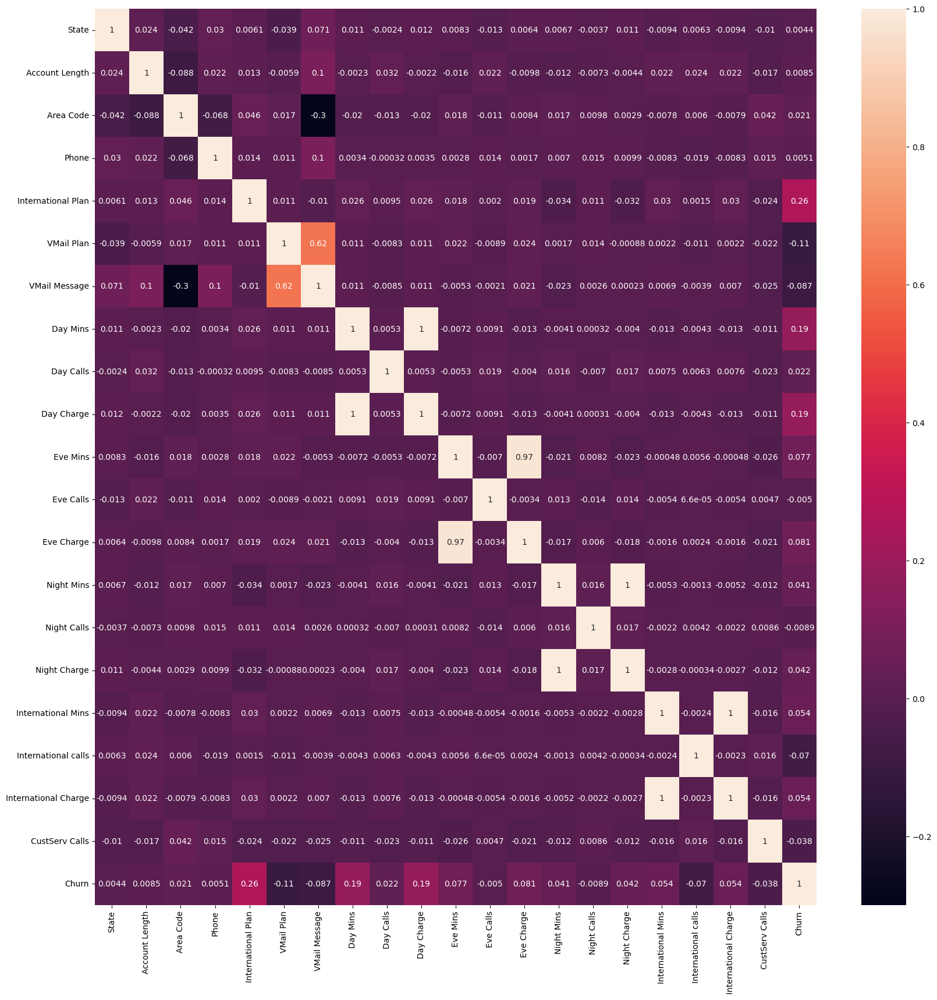

In [284]:
plt.figure(figsize=(20,20))
sns.heatmap(data.corr(),annot=True)

- eve charge
- eve mins

In [285]:
# dropping highly co - related values
data.drop(['Eve Charge','Eve Mins'],inplace=True,axis=1)

In [286]:
data.head()

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Calls,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn
0,16,128,415,2621,0,1,25,265.1,110,45.07,99,244.7,91,11.01,10.0,3,2.70,1,0
1,35,107,415,2120,0,1,26,161.6,123,27.47,103,254.4,103,11.45,13.7,3,3.70,1,0
2,31,137,415,1500,0,0,0,243.4,114,41.38,110,162.6,104,7.32,12.2,5,3.29,0,0
3,35,84,408,2313,1,0,0,299.4,71,50.90,88,196.9,89,8.86,6.6,7,1.78,2,0
4,36,75,415,150,1,0,0,166.7,113,28.34,122,186.9,121,8.41,10.1,3,2.73,3,0


### creating input and output variables

In [287]:
x= data.drop('Churn',axis=1)

In [288]:
Y=data.Churn

## train_test_split

In [289]:
from sklearn.model_selection import train_test_split

In [290]:
x_train,x_test,y_train,y_test= train_test_split(x,Y,test_size=0.30,random_state=42)

## Model building

- The target variable is categorical hence we use classification algorithms

### Logistic Regression

In [291]:
from sklearn.linear_model import LogisticRegression

In [292]:
model_log= LogisticRegression()

In [293]:
model_log.fit(x_train,y_train)

LogisticRegression()

In [294]:
y_pred_log_train= model_log.predict(x_train)

In [295]:
y_pred_log_train

array([0, 0, 0, ..., 0, 0, 0])

In [296]:
model_log.fit(x_test,y_test)

LogisticRegression()

In [297]:
y_pred_log_test= model_log.predict(x_test)

## Evaluation of Logistic Regression

In [298]:
from sklearn.metrics import confusion_matrix,recall_score,precision_score,accuracy_score,f1_score,classification_report

In [299]:
confusion_matrix(y_pred_log_train,y_train)

array([[2781,  448],
       [   0,    2]], dtype=int64)

In [300]:
confusion_matrix(y_pred_log_test,y_test)

array([[1194,  188],
       [   0,    4]], dtype=int64)

- There are 2780 identied as positive  and 7 as negative using train set 

- There are 1194 identified as positive and 4 as negative

In [301]:
recall_score(y_pred_log_train,y_train)*100

100.0

In [302]:
recall_score(y_pred_log_test,y_test)*100

100.0

In [303]:
precision_score(y_pred_log_train,y_train)*100

0.4444444444444444

In [304]:
precision_score(y_pred_log_test,y_test)*100

2.083333333333333

In [305]:
accuracy_score(y_pred_log_train,y_train)*100

86.13432373878057

In [306]:
accuracy_score(y_pred_log_test,y_test)*100

86.43578643578643

In [307]:
f1_score(y_pred_log_train,y_train)*100

0.8849557522123894

In [308]:
f1_score(y_pred_log_test,y_test)*100

4.081632653061225

In [309]:
print(classification_report(y_pred_log_train,y_train))

              precision    recall  f1-score   support

           0       1.00      0.86      0.93      3229
           1       0.00      1.00      0.01         2

    accuracy                           0.86      3231
   macro avg       0.50      0.93      0.47      3231
weighted avg       1.00      0.86      0.92      3231



In [310]:
print(classification_report(y_pred_log_test,y_test))

              precision    recall  f1-score   support

           0       1.00      0.86      0.93      1382
           1       0.02      1.00      0.04         4

    accuracy                           0.86      1386
   macro avg       0.51      0.93      0.48      1386
weighted avg       1.00      0.86      0.92      1386



- 86% accuracy on using logistic regression for train and test sets

In [311]:
data['Churn'].value_counts()

0    3975
1     642
Name: Churn, dtype: int64

- The target column is imbalanced hence we apply SMOTE to our logistic regression

## SMOTE for Logistic Regression

In [312]:
from imblearn.over_sampling import SMOTE

In [313]:
log_smote= SMOTE(random_state=4)

In [314]:
x_smote,y_smote= log_smote.fit_resample(x_train,y_train)

In [315]:
y_pred_smote= model_log.predict(x_smote)

#### Evaluation of smote using logistic regression

In [316]:
print(classification_report(y_smote,y_pred_smote))

              precision    recall  f1-score   support

           0       0.50      1.00      0.67      2781
           1       0.96      0.01      0.02      2781

    accuracy                           0.50      5562
   macro avg       0.73      0.50      0.34      5562
weighted avg       0.73      0.50      0.34      5562



- we have 50% accuracy on using logistic regression with SMOTE for the given dataset

## K- Nearest Neighbors Classifier

In [317]:
from sklearn.neighbors import KNeighborsClassifier

## finding the error rate 

In [324]:
error_rate=[]
for i in range(1,11):
    model_knn_2= KNeighborsClassifier(n_neighbors=i)
    model_knn_2.fit(x_train,y_train)
    y_knn_predict_2= model_knn_2.predict(x_test)
    error_rate.append(np.mean(y_knn_predict_2!=y_test))

In [325]:
error_rate

[0.20057720057720058,
 0.13564213564213565,
 0.14285714285714285,
 0.1370851370851371,
 0.1349206349206349,
 0.13347763347763347,
 0.13275613275613277,
 0.1378066378066378,
 0.1349206349206349,
 0.1378066378066378]

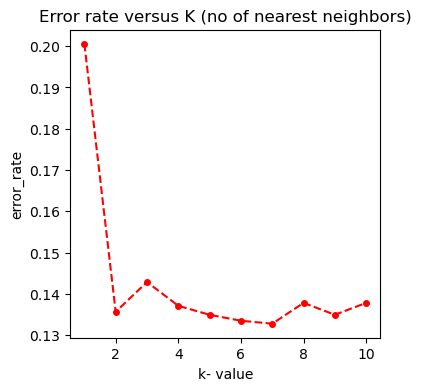

In [326]:
plt.figure(figsize=(4,4))
plt.plot(range(1,11),error_rate,color='red',linestyle='dashed',marker='o',markersize=4)
plt.title("Error rate versus K (no of nearest neighbors)")
plt.xlabel("k- value")
plt.ylabel("error_rate")
plt.show()

- From the graph we find that k-value of 7 has least errors in the data

In [327]:
#fitting the model with 7 nearest neighbors
model_knn_final= KNeighborsClassifier(n_neighbors=7)
model_knn_final.fit(x_train,y_train)
y_pred_knn_final = model_knn_final.predict(x_train)

In [328]:
model_knn_final.fit(x_test,y_test)
y_pred_knn_final_test= model_knn_final.predict(x_test)

### Evaluation of knn with best no of neighbors

In [329]:
print(classification_report(y_pred_knn_final,y_train))

              precision    recall  f1-score   support

           0       1.00      0.87      0.93      3174
           1       0.10      0.81      0.18        57

    accuracy                           0.87      3231
   macro avg       0.55      0.84      0.56      3231
weighted avg       0.98      0.87      0.92      3231



In [330]:
print(classification_report(y_pred_knn_final_test,y_test))

              precision    recall  f1-score   support

           0       1.00      0.87      0.93      1366
           1       0.09      0.90      0.17        20

    accuracy                           0.87      1386
   macro avg       0.55      0.89      0.55      1386
weighted avg       0.99      0.87      0.92      1386



- 87% accuracy on using Knn algorithm with 7 neighbors for train and test data

## K-Nearest Neighbors(SMOTE)

In [331]:
error_rate_smote=[]
for i in range(1,11):
    model_knn_smote= KNeighborsClassifier(n_neighbors=i)
    model_knn_smote.fit(x_smote,y_smote)
    y_pred_knn_smote= model_knn_smote.predict(x_test)
    error_rate_smote.append(np.mean(y_pred_knn_smote!=y_test))
error_rate_smote

[0.2857142857142857,
 0.2481962481962482,
 0.3225108225108225,
 0.28643578643578643,
 0.36147186147186144,
 0.3354978354978355,
 0.3924963924963925,
 0.35353535353535354,
 0.4126984126984127,
 0.37445887445887444]

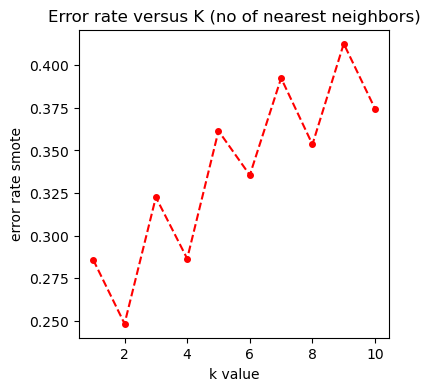

In [332]:
plt.figure(figsize=(4,4))
plt.plot(range(1,11),error_rate_smote,color='red',linestyle='dashed',marker='o',markersize=4)
plt.title('Error rate versus K (no of nearest neighbors)')
plt.xlabel('k value')
plt.ylabel('error rate smote')
plt.show()

In [333]:
model_knn_smote2= KNeighborsClassifier(n_neighbors=2)

In [334]:
model_knn_smote2.fit(x_smote,y_smote)

KNeighborsClassifier(n_neighbors=2)

In [335]:
y_pred_knn_smote2= model_knn_smote2.predict(x_test)

In [336]:
print(classification_report(y_test,y_pred_knn_smote2))

              precision    recall  f1-score   support

           0       0.88      0.83      0.85      1194
           1       0.21      0.28      0.24       192

    accuracy                           0.75      1386
   macro avg       0.54      0.55      0.54      1386
weighted avg       0.78      0.75      0.77      1386



- 75% accuracy for smote data using k-nearest neighbors

## Support vector classifier

In [337]:
from sklearn.svm import SVC

In [338]:
model_svc= SVC()

In [339]:
model_svc.fit(x_train,y_train)

SVC()

In [340]:
y_pred_svc= model_svc.predict(x_train)

In [341]:
#support vector classifier for test data
model_svc.fit(x_test,y_test)
y_pred_svc_test = model_svc.predict(x_test)

## Evaluation of Support Vector classifier

In [342]:
print(classification_report(y_pred_svc,y_train))

              precision    recall  f1-score   support

           0       1.00      0.86      0.93      3231
           1       0.00      0.00      0.00         0

    accuracy                           0.86      3231
   macro avg       0.50      0.43      0.46      3231
weighted avg       1.00      0.86      0.93      3231



In [343]:
print(classification_report(y_pred_svc_test,y_test))

              precision    recall  f1-score   support

           0       1.00      0.86      0.93      1386
           1       0.00      0.00      0.00         0

    accuracy                           0.86      1386
   macro avg       0.50      0.43      0.46      1386
weighted avg       1.00      0.86      0.93      1386



- 86% accuracy on train and test using Support vector classifier

## Support vector classifier(SMOTE)

In [344]:
model_svc_smote= SVC()

In [345]:
model_svc_smote.fit(x_smote,y_smote)

SVC()

In [346]:
y_pred_svc_smote= model_svc_smote.predict(x_test)

## Evaluation of support vector classifier(SMOTE)

In [347]:
print(classification_report(y_test,y_pred_svc_smote))

              precision    recall  f1-score   support

           0       0.90      0.68      0.77      1194
           1       0.20      0.51      0.29       192

    accuracy                           0.65      1386
   macro avg       0.55      0.59      0.53      1386
weighted avg       0.80      0.65      0.70      1386



- 65% accuracy on using support vector classifier using smote for the given data

## Desicion Tree

In [348]:
from sklearn.tree import DecisionTreeClassifier

In [349]:
model_dt= DecisionTreeClassifier()

In [350]:
model_dt.fit(x_train,y_train)

DecisionTreeClassifier()

In [351]:
y_pred_model_dt= model_dt.predict(x_train)

In [352]:
#desicion tree for test data
model_dt.fit(x_test,y_test)

DecisionTreeClassifier()

In [353]:
y_pred_model_dt_test= model_dt.predict(x_test)

## Evaluation of DecisionTree Classifier

In [354]:
print(classification_report(y_pred_model_dt,y_train))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2781
           1       1.00      1.00      1.00       450

    accuracy                           1.00      3231
   macro avg       1.00      1.00      1.00      3231
weighted avg       1.00      1.00      1.00      3231



In [355]:
print(classification_report(y_pred_model_dt_test,y_test))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1194
           1       1.00      1.00      1.00       192

    accuracy                           1.00      1386
   macro avg       1.00      1.00      1.00      1386
weighted avg       1.00      1.00      1.00      1386



- 100% accuracy for train and test data for desicion tree classifier for the given data

## Decision Tree classifier(SMOTE)

In [356]:
model_dt.fit(x_smote,y_smote)

DecisionTreeClassifier()

In [357]:
y_pred_dt_smote = model_dt.predict(x_test)

In [358]:
print(classification_report(y_test,y_pred_dt_smote))

              precision    recall  f1-score   support

           0       0.91      0.80      0.85      1194
           1       0.28      0.48      0.36       192

    accuracy                           0.76      1386
   macro avg       0.59      0.64      0.60      1386
weighted avg       0.82      0.76      0.78      1386



- 75% accuracy on applying smote to decision tree classifier to the given data

## Random Forest Classifier

In [359]:
from sklearn.ensemble import RandomForestClassifier

In [360]:
model_rf = RandomForestClassifier()

In [361]:
model_rf.fit(x_train,y_train)

RandomForestClassifier()

In [362]:
y_pred_rf  = model_rf.predict(x_train)

In [363]:
# random forest classifier for test data
model_rf.fit(x_test,y_test)

RandomForestClassifier()

In [364]:
y_pred_rf_test= model_rf.predict(x_test)

## Evaluation of Random forest classifier

In [365]:
print(classification_report(y_pred_rf,y_train))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2781
           1       1.00      1.00      1.00       450

    accuracy                           1.00      3231
   macro avg       1.00      1.00      1.00      3231
weighted avg       1.00      1.00      1.00      3231



In [366]:
print(classification_report(y_pred_rf_test,y_test))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1194
           1       1.00      1.00      1.00       192

    accuracy                           1.00      1386
   macro avg       1.00      1.00      1.00      1386
weighted avg       1.00      1.00      1.00      1386



- 100% accuracy on using random forest classifier for train and test  for the given data

## Random forest classifier(SMOTE)

In [367]:
model_rf.fit(x_smote,y_smote)

RandomForestClassifier()

In [368]:
y_pred_rf_smote= model_rf.predict(x_test)

In [369]:
print(classification_report(y_test,y_pred_rf_smote))

              precision    recall  f1-score   support

           0       0.91      0.93      0.92      1194
           1       0.52      0.45      0.48       192

    accuracy                           0.87      1386
   macro avg       0.72      0.69      0.70      1386
weighted avg       0.86      0.87      0.86      1386



- 86% accuracy on applying SMOTE to  Random forest Classifier algorithm for the given data

## Gradient Boosting

In [370]:
from sklearn.ensemble import GradientBoostingClassifier

In [371]:
model_gb= GradientBoostingClassifier()

In [372]:
model_gb.fit(x_train,y_train)

GradientBoostingClassifier()

In [373]:
y_pred_gb = model_gb.predict(x_train)

In [374]:
# applying test data to gradient boosting algorithm
model_gb.fit(x_test,y_test)

GradientBoostingClassifier()

In [375]:
y_pred_gb_test = model_gb.predict(x_test)

## Evaluation of Gradient Boosting classifier

In [376]:
print(classification_report(y_pred_gb,y_train))

              precision    recall  f1-score   support

           0       0.99      0.92      0.96      3001
           1       0.48      0.93      0.63       230

    accuracy                           0.92      3231
   macro avg       0.73      0.93      0.79      3231
weighted avg       0.96      0.92      0.93      3231



In [377]:
print(classification_report(y_pred_gb_test,y_test))

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1263
           1       0.62      0.98      0.76       123

    accuracy                           0.95      1386
   macro avg       0.81      0.96      0.87      1386
weighted avg       0.96      0.95      0.95      1386



- 92% accuracy for train data using gradient boosting algorithm
- 95% accuracy for test data using gradient boosting algorithm

## Gradient boosting classifier(SMOTE)

In [378]:
model_gb.fit(x_smote,y_smote)

GradientBoostingClassifier()

In [379]:
y_pred_model_gb = model_gb.predict(x_test)

## Evaluation of Gradient boosting classifier(SMOTE)

In [380]:
print(classification_report(y_pred_model_gb,y_test))

              precision    recall  f1-score   support

           0       0.90      0.93      0.92      1161
           1       0.57      0.48      0.52       225

    accuracy                           0.86      1386
   macro avg       0.74      0.71      0.72      1386
weighted avg       0.85      0.86      0.85      1386



- 86% accuracy on applying SMOTE to gradient boosting classifier for the given data

## Hyperparameter Tuning

#### Support vector Classifier

In [381]:
from sklearn.model_selection import GridSearchCV

In [382]:
param_grid={'C':[0.1,5,10,50,60,70],'gamma':[1,0.1,0.01,0.001,0.0001],'random_state':list(range(1,20))}

In [383]:
model_hyper_svc= SVC()

In [384]:
grid= GridSearchCV(model_hyper_svc,param_grid,verbose=2,scoring='accuracy',cv=5)

In [385]:
grid.fit(x,Y)

Fitting 5 folds for each of 570 candidates, totalling 2850 fits
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   1.9s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   1.9s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   2.0s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   1.9s
[CV] END .....................C=0.1, gamma=1, random_state=1; total time=   1.8s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   1.9s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   2.0s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   1.8s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   1.8s
[CV] END .....................C=0.1, gamma=1, random_state=2; total time=   1.8s
[CV] END .....................C=0.1, gamma=1, random_state=3; total time=   1.8s
[CV] END .....................C=0.1, gamma=1,

[CV] END ...................C=0.1, gamma=0.1, random_state=2; total time=   1.6s
[CV] END ...................C=0.1, gamma=0.1, random_state=2; total time=   1.8s
[CV] END ...................C=0.1, gamma=0.1, random_state=2; total time=   1.8s
[CV] END ...................C=0.1, gamma=0.1, random_state=2; total time=   1.7s
[CV] END ...................C=0.1, gamma=0.1, random_state=3; total time=   1.7s
[CV] END ...................C=0.1, gamma=0.1, random_state=3; total time=   1.7s
[CV] END ...................C=0.1, gamma=0.1, random_state=3; total time=   1.6s
[CV] END ...................C=0.1, gamma=0.1, random_state=3; total time=   1.7s
[CV] END ...................C=0.1, gamma=0.1, random_state=3; total time=   1.8s
[CV] END ...................C=0.1, gamma=0.1, random_state=4; total time=   1.7s
[CV] END ...................C=0.1, gamma=0.1, random_state=4; total time=   1.7s
[CV] END ...................C=0.1, gamma=0.1, random_state=4; total time=   1.7s
[CV] END ...................

[CV] END ..................C=0.1, gamma=0.01, random_state=3; total time=   1.5s
[CV] END ..................C=0.1, gamma=0.01, random_state=3; total time=   1.4s
[CV] END ..................C=0.1, gamma=0.01, random_state=4; total time=   1.5s
[CV] END ..................C=0.1, gamma=0.01, random_state=4; total time=   1.4s
[CV] END ..................C=0.1, gamma=0.01, random_state=4; total time=   1.4s
[CV] END ..................C=0.1, gamma=0.01, random_state=4; total time=   1.4s
[CV] END ..................C=0.1, gamma=0.01, random_state=4; total time=   1.6s
[CV] END ..................C=0.1, gamma=0.01, random_state=5; total time=   1.6s
[CV] END ..................C=0.1, gamma=0.01, random_state=5; total time=   1.7s
[CV] END ..................C=0.1, gamma=0.01, random_state=5; total time=   1.9s
[CV] END ..................C=0.1, gamma=0.01, random_state=5; total time=   1.6s
[CV] END ..................C=0.1, gamma=0.01, random_state=5; total time=   1.8s
[CV] END ..................C

[CV] END .................C=0.1, gamma=0.001, random_state=5; total time=   1.7s
[CV] END .................C=0.1, gamma=0.001, random_state=5; total time=   1.7s
[CV] END .................C=0.1, gamma=0.001, random_state=5; total time=   1.6s
[CV] END .................C=0.1, gamma=0.001, random_state=5; total time=   1.6s
[CV] END .................C=0.1, gamma=0.001, random_state=5; total time=   1.7s
[CV] END .................C=0.1, gamma=0.001, random_state=6; total time=   1.8s
[CV] END .................C=0.1, gamma=0.001, random_state=6; total time=   1.7s
[CV] END .................C=0.1, gamma=0.001, random_state=6; total time=   1.8s
[CV] END .................C=0.1, gamma=0.001, random_state=6; total time=   1.7s
[CV] END .................C=0.1, gamma=0.001, random_state=6; total time=   1.6s
[CV] END .................C=0.1, gamma=0.001, random_state=7; total time=   1.7s
[CV] END .................C=0.1, gamma=0.001, random_state=7; total time=   1.7s
[CV] END .................C=

[CV] END ................C=0.1, gamma=0.0001, random_state=6; total time=   0.7s
[CV] END ................C=0.1, gamma=0.0001, random_state=6; total time=   0.8s
[CV] END ................C=0.1, gamma=0.0001, random_state=6; total time=   0.7s
[CV] END ................C=0.1, gamma=0.0001, random_state=7; total time=   0.7s
[CV] END ................C=0.1, gamma=0.0001, random_state=7; total time=   0.8s
[CV] END ................C=0.1, gamma=0.0001, random_state=7; total time=   0.8s
[CV] END ................C=0.1, gamma=0.0001, random_state=7; total time=   0.8s
[CV] END ................C=0.1, gamma=0.0001, random_state=7; total time=   0.8s
[CV] END ................C=0.1, gamma=0.0001, random_state=8; total time=   0.8s
[CV] END ................C=0.1, gamma=0.0001, random_state=8; total time=   0.8s
[CV] END ................C=0.1, gamma=0.0001, random_state=8; total time=   0.8s
[CV] END ................C=0.1, gamma=0.0001, random_state=8; total time=   0.7s
[CV] END ................C=0

[CV] END .......................C=5, gamma=1, random_state=7; total time=   1.6s
[CV] END .......................C=5, gamma=1, random_state=8; total time=   1.6s
[CV] END .......................C=5, gamma=1, random_state=8; total time=   1.5s
[CV] END .......................C=5, gamma=1, random_state=8; total time=   1.8s
[CV] END .......................C=5, gamma=1, random_state=8; total time=   1.8s
[CV] END .......................C=5, gamma=1, random_state=8; total time=   1.8s
[CV] END .......................C=5, gamma=1, random_state=9; total time=   1.9s
[CV] END .......................C=5, gamma=1, random_state=9; total time=   1.9s
[CV] END .......................C=5, gamma=1, random_state=9; total time=   1.9s
[CV] END .......................C=5, gamma=1, random_state=9; total time=   1.9s
[CV] END .......................C=5, gamma=1, random_state=9; total time=   1.8s
[CV] END ......................C=5, gamma=1, random_state=10; total time=   1.8s
[CV] END ...................

[CV] END .....................C=5, gamma=0.1, random_state=9; total time=   3.0s
[CV] END .....................C=5, gamma=0.1, random_state=9; total time=   2.1s
[CV] END .....................C=5, gamma=0.1, random_state=9; total time=   2.2s
[CV] END .....................C=5, gamma=0.1, random_state=9; total time=   2.4s
[CV] END ....................C=5, gamma=0.1, random_state=10; total time=   2.2s
[CV] END ....................C=5, gamma=0.1, random_state=10; total time=   2.2s
[CV] END ....................C=5, gamma=0.1, random_state=10; total time=   2.1s
[CV] END ....................C=5, gamma=0.1, random_state=10; total time=   2.1s
[CV] END ....................C=5, gamma=0.1, random_state=10; total time=   2.1s
[CV] END ....................C=5, gamma=0.1, random_state=11; total time=   1.9s
[CV] END ....................C=5, gamma=0.1, random_state=11; total time=   2.0s
[CV] END ....................C=5, gamma=0.1, random_state=11; total time=   1.9s
[CV] END ...................

[CV] END ...................C=5, gamma=0.01, random_state=10; total time=   1.9s
[CV] END ...................C=5, gamma=0.01, random_state=10; total time=   1.9s
[CV] END ...................C=5, gamma=0.01, random_state=11; total time=   1.9s
[CV] END ...................C=5, gamma=0.01, random_state=11; total time=   1.9s
[CV] END ...................C=5, gamma=0.01, random_state=11; total time=   1.9s
[CV] END ...................C=5, gamma=0.01, random_state=11; total time=   1.8s
[CV] END ...................C=5, gamma=0.01, random_state=11; total time=   1.9s
[CV] END ...................C=5, gamma=0.01, random_state=12; total time=   1.8s
[CV] END ...................C=5, gamma=0.01, random_state=12; total time=   1.9s
[CV] END ...................C=5, gamma=0.01, random_state=12; total time=   1.9s
[CV] END ...................C=5, gamma=0.01, random_state=12; total time=   1.9s
[CV] END ...................C=5, gamma=0.01, random_state=12; total time=   1.8s
[CV] END ...................

[CV] END ..................C=5, gamma=0.001, random_state=12; total time=   1.7s
[CV] END ..................C=5, gamma=0.001, random_state=12; total time=   1.7s
[CV] END ..................C=5, gamma=0.001, random_state=12; total time=   1.8s
[CV] END ..................C=5, gamma=0.001, random_state=12; total time=   1.8s
[CV] END ..................C=5, gamma=0.001, random_state=12; total time=   1.8s
[CV] END ..................C=5, gamma=0.001, random_state=13; total time=   1.7s
[CV] END ..................C=5, gamma=0.001, random_state=13; total time=   1.8s
[CV] END ..................C=5, gamma=0.001, random_state=13; total time=   1.9s
[CV] END ..................C=5, gamma=0.001, random_state=13; total time=   1.8s
[CV] END ..................C=5, gamma=0.001, random_state=13; total time=   1.8s
[CV] END ..................C=5, gamma=0.001, random_state=14; total time=   1.8s
[CV] END ..................C=5, gamma=0.001, random_state=14; total time=   1.8s
[CV] END ..................C

[CV] END .................C=5, gamma=0.0001, random_state=13; total time=   0.8s
[CV] END .................C=5, gamma=0.0001, random_state=13; total time=   0.8s
[CV] END .................C=5, gamma=0.0001, random_state=13; total time=   0.8s
[CV] END .................C=5, gamma=0.0001, random_state=14; total time=   0.9s
[CV] END .................C=5, gamma=0.0001, random_state=14; total time=   0.9s
[CV] END .................C=5, gamma=0.0001, random_state=14; total time=   0.8s
[CV] END .................C=5, gamma=0.0001, random_state=14; total time=   0.9s
[CV] END .................C=5, gamma=0.0001, random_state=14; total time=   0.9s
[CV] END .................C=5, gamma=0.0001, random_state=15; total time=   0.9s
[CV] END .................C=5, gamma=0.0001, random_state=15; total time=   1.0s
[CV] END .................C=5, gamma=0.0001, random_state=15; total time=   1.0s
[CV] END .................C=5, gamma=0.0001, random_state=15; total time=   1.0s
[CV] END .................C=

[CV] END .....................C=10, gamma=1, random_state=14; total time=   2.1s
[CV] END .....................C=10, gamma=1, random_state=15; total time=   2.2s
[CV] END .....................C=10, gamma=1, random_state=15; total time=   2.2s
[CV] END .....................C=10, gamma=1, random_state=15; total time=   2.3s
[CV] END .....................C=10, gamma=1, random_state=15; total time=   2.2s
[CV] END .....................C=10, gamma=1, random_state=15; total time=   2.2s
[CV] END .....................C=10, gamma=1, random_state=16; total time=   2.0s
[CV] END .....................C=10, gamma=1, random_state=16; total time=   2.2s
[CV] END .....................C=10, gamma=1, random_state=16; total time=   2.0s
[CV] END .....................C=10, gamma=1, random_state=16; total time=   2.1s
[CV] END .....................C=10, gamma=1, random_state=16; total time=   2.0s
[CV] END .....................C=10, gamma=1, random_state=17; total time=   2.1s
[CV] END ...................

[CV] END ...................C=10, gamma=0.1, random_state=16; total time=   1.7s
[CV] END ...................C=10, gamma=0.1, random_state=16; total time=   1.6s
[CV] END ...................C=10, gamma=0.1, random_state=16; total time=   1.7s
[CV] END ...................C=10, gamma=0.1, random_state=16; total time=   1.6s
[CV] END ...................C=10, gamma=0.1, random_state=17; total time=   1.6s
[CV] END ...................C=10, gamma=0.1, random_state=17; total time=   1.8s
[CV] END ...................C=10, gamma=0.1, random_state=17; total time=   1.7s
[CV] END ...................C=10, gamma=0.1, random_state=17; total time=   1.8s
[CV] END ...................C=10, gamma=0.1, random_state=17; total time=   1.8s
[CV] END ...................C=10, gamma=0.1, random_state=18; total time=   1.8s
[CV] END ...................C=10, gamma=0.1, random_state=18; total time=   1.7s
[CV] END ...................C=10, gamma=0.1, random_state=18; total time=   1.7s
[CV] END ...................

[CV] END ..................C=10, gamma=0.01, random_state=17; total time=   2.3s
[CV] END ..................C=10, gamma=0.01, random_state=17; total time=   2.3s
[CV] END ..................C=10, gamma=0.01, random_state=18; total time=   2.1s
[CV] END ..................C=10, gamma=0.01, random_state=18; total time=   1.8s
[CV] END ..................C=10, gamma=0.01, random_state=18; total time=   2.2s
[CV] END ..................C=10, gamma=0.01, random_state=18; total time=   2.1s
[CV] END ..................C=10, gamma=0.01, random_state=18; total time=   1.9s
[CV] END ..................C=10, gamma=0.01, random_state=19; total time=   2.2s
[CV] END ..................C=10, gamma=0.01, random_state=19; total time=   2.4s
[CV] END ..................C=10, gamma=0.01, random_state=19; total time=   2.2s
[CV] END ..................C=10, gamma=0.01, random_state=19; total time=   2.1s
[CV] END ..................C=10, gamma=0.01, random_state=19; total time=   2.4s
[CV] END ..................C

[CV] END .................C=10, gamma=0.001, random_state=19; total time=   1.8s
[CV] END .................C=10, gamma=0.001, random_state=19; total time=   1.7s
[CV] END .................C=10, gamma=0.001, random_state=19; total time=   2.0s
[CV] END .................C=10, gamma=0.001, random_state=19; total time=   1.8s
[CV] END .................C=10, gamma=0.001, random_state=19; total time=   2.0s
[CV] END .................C=10, gamma=0.0001, random_state=1; total time=   1.0s
[CV] END .................C=10, gamma=0.0001, random_state=1; total time=   1.1s
[CV] END .................C=10, gamma=0.0001, random_state=1; total time=   1.0s
[CV] END .................C=10, gamma=0.0001, random_state=1; total time=   0.9s
[CV] END .................C=10, gamma=0.0001, random_state=1; total time=   0.9s
[CV] END .................C=10, gamma=0.0001, random_state=2; total time=   1.0s
[CV] END .................C=10, gamma=0.0001, random_state=2; total time=   1.0s
[CV] END .................C=

[CV] END ......................C=50, gamma=1, random_state=1; total time=   2.1s
[CV] END ......................C=50, gamma=1, random_state=1; total time=   2.1s
[CV] END ......................C=50, gamma=1, random_state=1; total time=   1.9s
[CV] END ......................C=50, gamma=1, random_state=2; total time=   1.9s
[CV] END ......................C=50, gamma=1, random_state=2; total time=   1.9s
[CV] END ......................C=50, gamma=1, random_state=2; total time=   1.9s
[CV] END ......................C=50, gamma=1, random_state=2; total time=   2.2s
[CV] END ......................C=50, gamma=1, random_state=2; total time=   1.9s
[CV] END ......................C=50, gamma=1, random_state=3; total time=   2.0s
[CV] END ......................C=50, gamma=1, random_state=3; total time=   1.9s
[CV] END ......................C=50, gamma=1, random_state=3; total time=   1.8s
[CV] END ......................C=50, gamma=1, random_state=3; total time=   2.1s
[CV] END ...................

[CV] END ....................C=50, gamma=0.1, random_state=2; total time=   2.2s
[CV] END ....................C=50, gamma=0.1, random_state=3; total time=   2.2s
[CV] END ....................C=50, gamma=0.1, random_state=3; total time=   2.4s
[CV] END ....................C=50, gamma=0.1, random_state=3; total time=   2.0s
[CV] END ....................C=50, gamma=0.1, random_state=3; total time=   2.1s
[CV] END ....................C=50, gamma=0.1, random_state=3; total time=   2.1s
[CV] END ....................C=50, gamma=0.1, random_state=4; total time=   2.0s
[CV] END ....................C=50, gamma=0.1, random_state=4; total time=   1.9s
[CV] END ....................C=50, gamma=0.1, random_state=4; total time=   2.1s
[CV] END ....................C=50, gamma=0.1, random_state=4; total time=   2.2s
[CV] END ....................C=50, gamma=0.1, random_state=4; total time=   2.2s
[CV] END ....................C=50, gamma=0.1, random_state=5; total time=   2.0s
[CV] END ...................

[CV] END ...................C=50, gamma=0.01, random_state=4; total time=   2.1s
[CV] END ...................C=50, gamma=0.01, random_state=4; total time=   2.1s
[CV] END ...................C=50, gamma=0.01, random_state=4; total time=   2.4s
[CV] END ...................C=50, gamma=0.01, random_state=4; total time=   2.0s
[CV] END ...................C=50, gamma=0.01, random_state=5; total time=   2.0s
[CV] END ...................C=50, gamma=0.01, random_state=5; total time=   3.4s
[CV] END ...................C=50, gamma=0.01, random_state=5; total time=   1.8s
[CV] END ...................C=50, gamma=0.01, random_state=5; total time=   2.1s
[CV] END ...................C=50, gamma=0.01, random_state=5; total time=   2.0s
[CV] END ...................C=50, gamma=0.01, random_state=6; total time=   2.3s
[CV] END ...................C=50, gamma=0.01, random_state=6; total time=   2.0s
[CV] END ...................C=50, gamma=0.01, random_state=6; total time=   2.1s
[CV] END ...................

[CV] END ..................C=50, gamma=0.001, random_state=5; total time=   1.9s
[CV] END ..................C=50, gamma=0.001, random_state=5; total time=   1.7s
[CV] END ..................C=50, gamma=0.001, random_state=6; total time=   1.7s
[CV] END ..................C=50, gamma=0.001, random_state=6; total time=   1.9s
[CV] END ..................C=50, gamma=0.001, random_state=6; total time=   1.8s
[CV] END ..................C=50, gamma=0.001, random_state=6; total time=   1.9s
[CV] END ..................C=50, gamma=0.001, random_state=6; total time=   1.9s
[CV] END ..................C=50, gamma=0.001, random_state=7; total time=   1.8s
[CV] END ..................C=50, gamma=0.001, random_state=7; total time=   1.8s
[CV] END ..................C=50, gamma=0.001, random_state=7; total time=   1.8s
[CV] END ..................C=50, gamma=0.001, random_state=7; total time=   1.8s
[CV] END ..................C=50, gamma=0.001, random_state=7; total time=   1.9s
[CV] END ..................C

[CV] END .................C=50, gamma=0.0001, random_state=7; total time=   0.9s
[CV] END .................C=50, gamma=0.0001, random_state=7; total time=   0.8s
[CV] END .................C=50, gamma=0.0001, random_state=7; total time=   0.8s
[CV] END .................C=50, gamma=0.0001, random_state=7; total time=   0.9s
[CV] END .................C=50, gamma=0.0001, random_state=7; total time=   0.9s
[CV] END .................C=50, gamma=0.0001, random_state=8; total time=   0.9s
[CV] END .................C=50, gamma=0.0001, random_state=8; total time=   0.7s
[CV] END .................C=50, gamma=0.0001, random_state=8; total time=   0.8s
[CV] END .................C=50, gamma=0.0001, random_state=8; total time=   0.9s
[CV] END .................C=50, gamma=0.0001, random_state=8; total time=   0.9s
[CV] END .................C=50, gamma=0.0001, random_state=9; total time=   0.9s
[CV] END .................C=50, gamma=0.0001, random_state=9; total time=   0.9s
[CV] END .................C=

[CV] END ......................C=60, gamma=1, random_state=8; total time=   1.8s
[CV] END ......................C=60, gamma=1, random_state=8; total time=   1.9s
[CV] END ......................C=60, gamma=1, random_state=8; total time=   1.9s
[CV] END ......................C=60, gamma=1, random_state=9; total time=   1.9s
[CV] END ......................C=60, gamma=1, random_state=9; total time=   1.8s
[CV] END ......................C=60, gamma=1, random_state=9; total time=   1.8s
[CV] END ......................C=60, gamma=1, random_state=9; total time=   1.8s
[CV] END ......................C=60, gamma=1, random_state=9; total time=   1.9s
[CV] END .....................C=60, gamma=1, random_state=10; total time=   1.9s
[CV] END .....................C=60, gamma=1, random_state=10; total time=   1.9s
[CV] END .....................C=60, gamma=1, random_state=10; total time=   1.8s
[CV] END .....................C=60, gamma=1, random_state=10; total time=   1.8s
[CV] END ...................

[CV] END ....................C=60, gamma=0.1, random_state=9; total time=   2.6s
[CV] END ...................C=60, gamma=0.1, random_state=10; total time=   1.7s
[CV] END ...................C=60, gamma=0.1, random_state=10; total time=   1.9s
[CV] END ...................C=60, gamma=0.1, random_state=10; total time=   1.6s
[CV] END ...................C=60, gamma=0.1, random_state=10; total time=   1.9s
[CV] END ...................C=60, gamma=0.1, random_state=10; total time=   1.8s
[CV] END ...................C=60, gamma=0.1, random_state=11; total time=   1.8s
[CV] END ...................C=60, gamma=0.1, random_state=11; total time=   1.9s
[CV] END ...................C=60, gamma=0.1, random_state=11; total time=   1.9s
[CV] END ...................C=60, gamma=0.1, random_state=11; total time=   1.9s
[CV] END ...................C=60, gamma=0.1, random_state=11; total time=   1.9s
[CV] END ...................C=60, gamma=0.1, random_state=12; total time=   1.8s
[CV] END ...................

[CV] END ..................C=60, gamma=0.01, random_state=11; total time=   1.9s
[CV] END ..................C=60, gamma=0.01, random_state=11; total time=   1.9s
[CV] END ..................C=60, gamma=0.01, random_state=11; total time=   2.0s
[CV] END ..................C=60, gamma=0.01, random_state=11; total time=   1.8s
[CV] END ..................C=60, gamma=0.01, random_state=12; total time=   1.8s
[CV] END ..................C=60, gamma=0.01, random_state=12; total time=   1.9s
[CV] END ..................C=60, gamma=0.01, random_state=12; total time=   1.7s
[CV] END ..................C=60, gamma=0.01, random_state=12; total time=   1.8s
[CV] END ..................C=60, gamma=0.01, random_state=12; total time=   1.8s
[CV] END ..................C=60, gamma=0.01, random_state=13; total time=   2.0s
[CV] END ..................C=60, gamma=0.01, random_state=13; total time=   1.9s
[CV] END ..................C=60, gamma=0.01, random_state=13; total time=   2.0s
[CV] END ..................C

[CV] END .................C=60, gamma=0.001, random_state=12; total time=   1.8s
[CV] END .................C=60, gamma=0.001, random_state=12; total time=   1.9s
[CV] END .................C=60, gamma=0.001, random_state=13; total time=   1.8s
[CV] END .................C=60, gamma=0.001, random_state=13; total time=   1.9s
[CV] END .................C=60, gamma=0.001, random_state=13; total time=   1.9s
[CV] END .................C=60, gamma=0.001, random_state=13; total time=   1.8s
[CV] END .................C=60, gamma=0.001, random_state=13; total time=   1.7s
[CV] END .................C=60, gamma=0.001, random_state=14; total time=   1.8s
[CV] END .................C=60, gamma=0.001, random_state=14; total time=   1.8s
[CV] END .................C=60, gamma=0.001, random_state=14; total time=   1.9s
[CV] END .................C=60, gamma=0.001, random_state=14; total time=   1.8s
[CV] END .................C=60, gamma=0.001, random_state=14; total time=   1.8s
[CV] END .................C=

[CV] END ................C=60, gamma=0.0001, random_state=14; total time=   0.9s
[CV] END ................C=60, gamma=0.0001, random_state=14; total time=   0.9s
[CV] END ................C=60, gamma=0.0001, random_state=14; total time=   0.9s
[CV] END ................C=60, gamma=0.0001, random_state=14; total time=   0.9s
[CV] END ................C=60, gamma=0.0001, random_state=14; total time=   0.8s
[CV] END ................C=60, gamma=0.0001, random_state=15; total time=   0.9s
[CV] END ................C=60, gamma=0.0001, random_state=15; total time=   0.9s
[CV] END ................C=60, gamma=0.0001, random_state=15; total time=   0.9s
[CV] END ................C=60, gamma=0.0001, random_state=15; total time=   0.9s
[CV] END ................C=60, gamma=0.0001, random_state=15; total time=   0.8s
[CV] END ................C=60, gamma=0.0001, random_state=16; total time=   0.8s
[CV] END ................C=60, gamma=0.0001, random_state=16; total time=   0.8s
[CV] END ................C=6

[CV] END .....................C=70, gamma=1, random_state=15; total time=   1.8s
[CV] END .....................C=70, gamma=1, random_state=15; total time=   1.8s
[CV] END .....................C=70, gamma=1, random_state=15; total time=   1.9s
[CV] END .....................C=70, gamma=1, random_state=16; total time=   1.9s
[CV] END .....................C=70, gamma=1, random_state=16; total time=   1.9s
[CV] END .....................C=70, gamma=1, random_state=16; total time=   1.9s
[CV] END .....................C=70, gamma=1, random_state=16; total time=   2.0s
[CV] END .....................C=70, gamma=1, random_state=16; total time=   1.9s
[CV] END .....................C=70, gamma=1, random_state=17; total time=   1.9s
[CV] END .....................C=70, gamma=1, random_state=17; total time=   1.9s
[CV] END .....................C=70, gamma=1, random_state=17; total time=   1.9s
[CV] END .....................C=70, gamma=1, random_state=17; total time=   1.9s
[CV] END ...................

[CV] END ...................C=70, gamma=0.1, random_state=16; total time=   1.9s
[CV] END ...................C=70, gamma=0.1, random_state=17; total time=   1.9s
[CV] END ...................C=70, gamma=0.1, random_state=17; total time=   1.8s
[CV] END ...................C=70, gamma=0.1, random_state=17; total time=   1.8s
[CV] END ...................C=70, gamma=0.1, random_state=17; total time=   1.9s
[CV] END ...................C=70, gamma=0.1, random_state=17; total time=   1.8s
[CV] END ...................C=70, gamma=0.1, random_state=18; total time=   1.8s
[CV] END ...................C=70, gamma=0.1, random_state=18; total time=   1.9s
[CV] END ...................C=70, gamma=0.1, random_state=18; total time=   1.9s
[CV] END ...................C=70, gamma=0.1, random_state=18; total time=   1.9s
[CV] END ...................C=70, gamma=0.1, random_state=18; total time=   1.9s
[CV] END ...................C=70, gamma=0.1, random_state=19; total time=   1.9s
[CV] END ...................

[CV] END ..................C=70, gamma=0.01, random_state=18; total time=   1.8s
[CV] END ..................C=70, gamma=0.01, random_state=18; total time=   1.8s
[CV] END ..................C=70, gamma=0.01, random_state=18; total time=   1.8s
[CV] END ..................C=70, gamma=0.01, random_state=18; total time=   1.9s
[CV] END ..................C=70, gamma=0.01, random_state=19; total time=   1.8s
[CV] END ..................C=70, gamma=0.01, random_state=19; total time=   1.8s
[CV] END ..................C=70, gamma=0.01, random_state=19; total time=   1.8s
[CV] END ..................C=70, gamma=0.01, random_state=19; total time=   1.9s
[CV] END ..................C=70, gamma=0.01, random_state=19; total time=   1.8s
[CV] END ..................C=70, gamma=0.001, random_state=1; total time=   1.9s
[CV] END ..................C=70, gamma=0.001, random_state=1; total time=   1.9s
[CV] END ..................C=70, gamma=0.001, random_state=1; total time=   1.8s
[CV] END ..................C

[CV] END .................C=70, gamma=0.001, random_state=19; total time=   1.8s
[CV] END .................C=70, gamma=0.001, random_state=19; total time=   1.8s
[CV] END .................C=70, gamma=0.0001, random_state=1; total time=   0.8s
[CV] END .................C=70, gamma=0.0001, random_state=1; total time=   0.9s
[CV] END .................C=70, gamma=0.0001, random_state=1; total time=   0.8s
[CV] END .................C=70, gamma=0.0001, random_state=1; total time=   0.8s
[CV] END .................C=70, gamma=0.0001, random_state=1; total time=   0.9s
[CV] END .................C=70, gamma=0.0001, random_state=2; total time=   0.9s
[CV] END .................C=70, gamma=0.0001, random_state=2; total time=   0.9s
[CV] END .................C=70, gamma=0.0001, random_state=2; total time=   0.9s
[CV] END .................C=70, gamma=0.0001, random_state=2; total time=   0.9s
[CV] END .................C=70, gamma=0.0001, random_state=2; total time=   0.9s
[CV] END .................C=

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.1, 5, 10, 50, 60, 70],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'random_state': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                          13, 14, 15, 16, 17, 18, 19]},
             scoring='accuracy', verbose=2)

In [386]:
print(grid.best_params_)

{'C': 0.1, 'gamma': 1, 'random_state': 1}


In [387]:
model_hyper_svc= SVC(C=0.1,gamma=1,random_state=1)

In [388]:
model_hyper_svc.fit(x_train,y_train)

SVC(C=0.1, gamma=1, random_state=1)

In [389]:
y_pred_svc_hyper= model_hyper_svc.predict(x_train)

In [390]:
#Using test data for Support vector classifier by applying hyperparameters
model_hyper_svc.fit(x_test,y_test)

SVC(C=0.1, gamma=1, random_state=1)

In [391]:
y_pred_svc_hyper_test= model_hyper_svc.predict(x_test)

#### Evaluation of support vector classifier using hyperparametrs

In [392]:
print(classification_report(y_pred_svc_hyper,y_train))

              precision    recall  f1-score   support

           0       1.00      0.86      0.93      3231
           1       0.00      0.00      0.00         0

    accuracy                           0.86      3231
   macro avg       0.50      0.43      0.46      3231
weighted avg       1.00      0.86      0.93      3231



In [393]:
print(classification_report(y_pred_svc_hyper_test,y_test))

              precision    recall  f1-score   support

           0       1.00      0.86      0.93      1386
           1       0.00      0.00      0.00         0

    accuracy                           0.86      1386
   macro avg       0.50      0.43      0.46      1386
weighted avg       1.00      0.86      0.93      1386



- 86% accuracy on using support vector classifier with hyperparameters for train and test data

#### SMOTE for hyperparameter tuning using Support vector classifier

In [394]:
model_hyper_svc.fit(x_smote,y_smote)

SVC(C=0.1, gamma=1, random_state=1)

In [395]:
y_pred_hyper_svc_smote= model_hyper_svc.predict(x_test)

#### Evaluation of hyperparameter tuning using Support vector classifier(SMOTE)

In [396]:
print(classification_report(y_test,y_pred_hyper_svc_smote))

              precision    recall  f1-score   support

           0       1.00      0.01      0.02      1194
           1       0.14      1.00      0.24       192

    accuracy                           0.15      1386
   macro avg       0.57      0.50      0.13      1386
weighted avg       0.88      0.15      0.05      1386



- 15% accuracy on using SMOTE for hyperparameter tuning using support vector classifier

#### Descision Tree

In [397]:
param_grid={
    "criterion": ("gini","entropy"),
    "splitter": ("best","random"),
    "max_depth": list(range(1,21)),
    "min_samples_split": [2,3,4],
    "min_samples_leaf": list(range(1,21)),
    "random_state":list(range(1,11))
}

In [398]:
grid_dt = GridSearchCV(model_dt,param_grid,verbose=2,n_jobs=1,cv=3)

In [399]:
grid_dt.fit(x,Y)

Fitting 3 folds for each of 48000 candidates, totalling 144000 fits
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini

[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=2, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=2, rando

[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=5, min_samples_split=3, random

[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=7, min_samples_split=4, random

[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=2, ran

[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=10, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=11, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=2,

[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=13, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=3, 

[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=14, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=15, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=16, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=3, 

[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=17, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=18, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=2,

[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=1, min_samples_leaf=20, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_

[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=4, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=9, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=10, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=11, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=12, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=3, 

[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=13, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=14, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=15, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=16, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=17, min_samples_split=4

[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=3, 

[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=18, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=19, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=2, r

[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=2, min_samples_leaf=20, min_samples_split=4,

[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_s

[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=3, random

[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_

[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_stat

[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=10, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=11, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=12, min_samples_split=

[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=13, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=2, r

[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=14, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=15, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=3,

[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=16, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=17, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=3,

[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=18, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=19, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=

[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=3, min_samples_leaf=20, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=3, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_stat

[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=2, rando

[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=6, min_samples_split=4, random_s

[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=3, random

[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=10, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=4

[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=2, 

[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=12, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=13, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=3, r

[CV] END criterion=gini, max_depth=4, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=2, r

[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=15, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=2

[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=17, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=18, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=19, min_samples_split=4

[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=4, min_samples_leaf=20, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_stat

[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_s

[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_s

[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_stat

[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=2, random_

[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=10, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=2, r

[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=11, min_samples_split=4, 

[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=12, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=13, min_samples_split=3, r

[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=14, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=15, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=16, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=17, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=18, min_samples_split=4,

[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=19, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=5, min_samples_leaf=20, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=2, random_s

[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_stat

[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=5, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_st

[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=8, min_samples_split=4, random

[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=10, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=11, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=12, min_samples_split=3

[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=13, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=2,

[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=15, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=16, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=17, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=18, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=19, min_samples_split=4, ran

[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=6, min_samples_leaf=20, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_st

[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=2, min_samples_split=4, random

[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=3, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=2, random

[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_

[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=10, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=11, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=2, ran

[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=12, min_samples_split=

[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=13, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=14, min_samples_split=4, r

[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=15, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=16, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=2, r

[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=17, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=18, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=19, min_samples_split=4, r

[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=3

[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=7, min_samples_leaf=20, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_

[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_

[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_

[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=10, min_samples_split=

[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=3,

[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=11, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=12, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=13, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=2, r

[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=14, min_samples_split=4,

[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=15, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=16, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=17, min_samples_split=4, 

[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=18, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=19, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=3,

[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=8, min_samples_leaf=20, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=3, random

[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_sta

[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_sta

[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=2, random

[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_sta

[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state

[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=10, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=11, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=12, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=13, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=2,

[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=15, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=16, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=17, min_samples_split=4, 

[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=18, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=19, min_samples_split=4, ran

[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=3, 

[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=9, min_samples_leaf=20, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=1, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=2, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=2

[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=3, min_samples_split=4,

[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=4, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=5, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=6, min_samples_split=4

[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=7, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=8, min_samples_split=

[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=9, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=11, min_samples_spli

[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_

[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_spl

[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_sampl

[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_s

[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_sp

[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_spl

[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=16, min_samples_spl

[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_sp

[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_

[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=19, min_samples_spl

[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=10, min_samples_leaf=20, min_samples_

[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=1, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=2, min_samples_split=4, ran

[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=3, 

[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=3, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=4, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=5, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=3

[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=6, min_samples_split=4, 

[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=7, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=8, min_samples_split=4, ran

[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=3, 

[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=9, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_spli

[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=12, min_samples_s

[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=13, min_samples_spl

[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_spli

[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples

[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples

[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_spl

[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=19, min_samples_spl

[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_spl

[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=11, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=1, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=2, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=3, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=4, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=5, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=2, ran

[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=6, min_samples_split=4, 

[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=7, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=8, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=3, r

[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_spl

[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_spli

[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples

[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=13, min_samples_spl

[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_spl

[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_spl

[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=15, min_samples_spli

[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_spl

[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_spli

[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples

[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_spl

[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=12, min_samples_leaf=20, min_samples_spl

[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=1, min_samples_split=4, ran

[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=3

[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=2, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=3, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=4, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=2, r

[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=5, min_samples_split=4

[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=6, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=7, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=2

[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=9, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_spli

[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_sampl

[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_s

[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_spl

[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_spl

[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=14, min_samples

[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_spl

[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_spl

[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_spl

[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_spl

[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_s

[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples

[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=13, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=1, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=2, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=3, min_samples_split=4,

[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=4, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=5, min_samples_split=4, ran

[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=3, 

[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=6, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=7, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=8, min_samples_split=4

[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=3,

[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=9, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=11, min_samples_spli

[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples

[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_spl

[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=14, min_samples_spl

[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_s

[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=15, min_samples_spl

[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_spl

[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_spl

[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=17, min_samples_spl

[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples

[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_spli

[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_sample

[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=1, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=2, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=3, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=2, ran

[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=4, min_samples_split=4

[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=5, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=6, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=7, min_samples_split=4

[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=8, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=9, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_

[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=12, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=13, min_samples_

[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=14, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_spli

[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=16, min_samples_s

[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=17, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_spl

[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=19, min_sample

[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=15, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=1, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=2, min_samples_split=4, ran

[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=3

[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=3, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=4, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=3, ran

[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=2, 

[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=6, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=7, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=2, 

[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=9, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=10, min_samples_spl

[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_spl

[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=12, min_sample

[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=13, min_samples_spl

[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples

[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=16, min_samples_spl

[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_spl

[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_s

[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_sp

[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=19, min_samples_spl

[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_spl

[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_spl

[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=16, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=1, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=2, ran

[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=2, min_samples_split=4, 

[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=3, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=4, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=5, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=6, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=2

[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=8, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=9, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples

[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_

[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_sp

[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_spl

[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=14, min_samples_s

[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_spl

[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=17, min_samples_sp

[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_

[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=19, min_samples_spl

[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_spl

[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=1, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=2, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=3, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=3

[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=2,

[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=5, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=6, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=3, ran

[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=2

[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=8, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=9, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_spli

[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples

[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_s

[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=12, min_samples_spl

[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_spli

[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_

[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=15, min_samples_spl

[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=16, min_samples_spl

[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=19, min_samples_spl

[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_spl

[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=18, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=1, min_samples_split=4, r

[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=3

[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=2, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=3, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=4, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=5, min_samples_split=4, 

[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=6, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=7, min_samples_split=4, ran

[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=8, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=9, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_sp

[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=10, min_samples

[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_spl

[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=13, min_samples

[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples

[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=16, min_samples_

[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=17, min_samples_spl

[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_spl

[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples

[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=19, min_samples_leaf=20, min_samples_spl

[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=1, min_samples_split=4, ra

[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=2, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=2, ran

[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=3, min_samples_split=4, 

[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=3, ra

[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=4, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=5, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=2, ran

[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=

[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=2,

[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=7, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=2, ra

[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=3, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=8, min_samples_split=4, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=2, rand

[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=9, min_samples_split=3, ran

[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_spl

[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=10, min_samples_spl

[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_spl

[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=11, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=12, min_samples_

[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=13, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=14, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_spli

[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=15, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=16, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_spl

[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=17, min_samples_spl

[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples

[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=18, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=19, min_samples_spl

[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split

[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=gini, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samp

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=2, min_sa

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_sam

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=4, min

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_sam

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samp

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_sam

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, mi

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=9, min_s

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=1

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11,

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12,

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13,

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_le

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14,

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=14, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=16,

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=17,

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=19,

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=1, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_s

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_sam

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=3, min_sam

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=4, min_sam

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=7, min_s

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_sam

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_lea

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=13,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=14

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=15,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=1

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20,

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=2, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_sam

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=2, min_sam

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=4, min_sam

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_sam

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=5, min_sam

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=7, min_samp

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=8, min_sam

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11,

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12,

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, 

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14,

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=14, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15,

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=1

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17,

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17,

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=17,

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=3, min_samples_leaf=20,

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_sa

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=1, min_s

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_sam

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_sam

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=3, min_sam

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_sam

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_sam

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=8, min_sam

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10,

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11,

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_lea

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=14

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15,

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=15,

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=17,

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18,

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=18, 

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=4, min_samples_leaf=20

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_sam

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_sam

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_sam

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=3, min_

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_s

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_sam

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=7, min_sam

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_sa

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_s

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10,

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=10,

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11,

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=12,

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13,

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16,

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=1

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=18,

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=19,

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20,

[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=5, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samp

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=1, min_sa

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_sam

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samp

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_sa

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_sa

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samp

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=13,

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14,

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=14,

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=16,

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, 

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20,

[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=6, min_samples_leaf=20, 

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_sam

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=3, min_sam

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_sam

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samp

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_sam

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=9, min_s

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11,

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12,

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14,

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14,

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_le

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=15,

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19,

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=7, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samp

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_s

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=2, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_sam

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=4, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_s

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_sam

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=6, min_sam

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10,

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11,

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12,

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13,

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=13, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16,

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=16,

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=17, 

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=1

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=8, min_samples_leaf=20,

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_sa

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=2, min_

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_sam

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=3, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_sam

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=4, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=5, min_sam

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_s

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=6, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=7, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=8, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_sampl

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_sam

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=10,

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=11, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12,

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=12, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, 

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=1

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14,

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=14, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=15, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=17,

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=18, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, 

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=19, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, m

[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=9, min_samples_leaf=20,

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_lea

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=3,

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5,

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=5

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_lea

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samp

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=11, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samp

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_sample

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_sampl

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=10, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1,

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=1, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=2, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5,

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_lea

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6,

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8,

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=8, 

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_lea

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=12, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_l

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samp

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_sampl

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_sample

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_sam

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samp

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_le

[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=11, min_samples_

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_lea

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7,

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=9, 

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_sampl

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_l

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_sampl

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_l

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_sampl

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=12, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1,

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=1,

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, 

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3,

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5,

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, 

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_lea

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_lea

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_sampl

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=11, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_sample

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_l

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_sampl

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_sample

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=13, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1,

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1,

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=1,

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_lea

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6,

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, 

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=6

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9,

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_l

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samp

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=13, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_l

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_sampl

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=15, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=17, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_sampl

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_le

[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_leaf=20, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=14, min_samples_

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=2, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3,

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5,

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_lea

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=6

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8,

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_lea

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=13, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samp

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_l

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samp

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=15, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, 

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=2, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7,

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7,

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, 

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=9, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=14, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_sampl

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=15, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samp

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=19, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_leaf=20, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=16, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1,

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_lea

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3,

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5,

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6,

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=6, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8,

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_l

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=10, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samp

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_sampl

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_sample

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=11, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_sample

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=14, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=15, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=16, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_sampl

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=17, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=18, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_

[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=17, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1,

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=2, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=3,

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5,

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_lea

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=8, 

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=10, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=12, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=13, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_l

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samp

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=14, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_sample

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=15, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=16, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=17, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_l

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=18, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samp

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=19, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_sampl

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_le

[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=18, min_samples_

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=1, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=2,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=3, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=6,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=7, 

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=8

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=9,

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=10, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=11, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_l

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=12, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samp

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=13, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=14, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=15, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=16, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=17, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_sample

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=18, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=19, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_leaf=20, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=19, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, 

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=1, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_lea

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=2, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=3,

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=4,

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=5

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=6, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=7, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8,

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=8, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=2, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9,

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=9, m

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=10, min_samples_split=4, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=3, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=11, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_sample

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=2, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=3, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=12, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=13, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=14, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_l

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=15, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_sa

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=2, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_sample

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=16, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=2, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=3, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=3, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=4, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=17, min_samples_split=4, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=5, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=2, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=3, random_state=6, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=3, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=7, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=18, min_samples_split=4, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=8, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=2, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=9, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=3, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=19, min_samples_split=4, random_state=10, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=2, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samp

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=1, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=3, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=2, splitter=random; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_leaf=20, min_samples_split=4, random_state=3, splitter=best; total time=   0.0s
[CV] END criterion=entropy, max_depth=20, min_samples_le

GridSearchCV(cv=3, estimator=DecisionTreeClassifier(), n_jobs=1,
             param_grid={'criterion': ('gini', 'entropy'),
                         'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                       13, 14, 15, 16, 17, 18, 19, 20],
                         'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
                                              12, 13, 14, 15, 16, 17, 18, 19,
                                              20],
                         'min_samples_split': [2, 3, 4],
                         'random_state': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'splitter': ('best', 'random')},
             verbose=2)

In [400]:
print(grid_dt.best_params_)

{'criterion': 'gini', 'max_depth': 4, 'min_samples_leaf': 1, 'min_samples_split': 2, 'random_state': 1, 'splitter': 'best'}


In [401]:
model_hyper_dt= DecisionTreeClassifier(criterion='gini',max_depth=4,min_samples_leaf=1,min_samples_split=2,random_state=1,splitter='best')

In [402]:
model_hyper_dt.fit(x_train,y_train)

DecisionTreeClassifier(max_depth=4, random_state=1)

In [403]:
y_pred_hyper_dt = model_hyper_dt.predict(x_train)

In [404]:
# applying test data to decision tree classifier with hyperparameters
model_hyper_dt.fit(x_test,y_test)

DecisionTreeClassifier(max_depth=4, random_state=1)

In [405]:
y_pred_hyper_dt_test = model_hyper_dt.predict(x_test)

#### Evaluation of Decision tree classifier with best hyperparameters

In [406]:
print(classification_report(y_pred_hyper_dt,y_train))

              precision    recall  f1-score   support

           0       0.99      0.91      0.95      3027
           1       0.41      0.91      0.57       204

    accuracy                           0.91      3231
   macro avg       0.70      0.91      0.76      3231
weighted avg       0.96      0.91      0.93      3231



In [407]:
print(classification_report(y_pred_svc_hyper_test,y_test))

              precision    recall  f1-score   support

           0       1.00      0.86      0.93      1386
           1       0.00      0.00      0.00         0

    accuracy                           0.86      1386
   macro avg       0.50      0.43      0.46      1386
weighted avg       1.00      0.86      0.93      1386



- 91% accuracy on using decision tree classifier with best parameters for train data
- 86% accuracy on using decision tree classifier with best parameters for test data

#### Decision tree classifier with best Hyperparameters(SMOTE)

In [408]:
model_hyper_dt.fit(x_smote,y_smote)

DecisionTreeClassifier(max_depth=4, random_state=1)

In [409]:
y_pred_hyper_dt_smote= model_hyper_dt.predict(x_test)

#### Evaluation of Decision tree classifier with best hyperparametrs(SMOTE)

In [410]:
print(classification_report(y_pred_hyper_dt_smote,y_test))

              precision    recall  f1-score   support

           0       0.94      0.90      0.92      1253
           1       0.35      0.50      0.41       133

    accuracy                           0.86      1386
   macro avg       0.65      0.70      0.67      1386
weighted avg       0.89      0.86      0.87      1386



- 86% accuracy on appying descision tree algorithm with best hyperparametrs with SMOTE

#### Random Forest

In [411]:
n_estimators = [int(i) for i in np.linspace(start=200, stop=2000, num=10)]
max_features = ['auto','sqrt']
max_depth = [int(i) for i in np.linspace(start=10, stop=110, num=10)]
max_depth.append(None)
min_samples_split = [2,5,10]
min_samples_leaf = [1,2,4]
bootstrap = [True,False]


Random_grid = {'n_estimators':n_estimators,
               'max_features':max_features,
               'max_depth':max_depth,
               'min_samples_split':min_samples_split,
               'min_samples_leaf':min_samples_leaf,
               'bootstrap': bootstrap
              }

In [412]:
from sklearn.model_selection import RandomizedSearchCV

In [413]:
model_hyper_rf = RandomizedSearchCV(estimator=model_rf,scoring='f1',param_distributions=Random_grid,n_iter=100,cv=5,verbose=2,random_state=42, n_jobs=-1)

In [414]:
model_hyper_rf.fit(x,Y)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 21, 32, 43, 54, 65,
                                                      76, 87, 98, 110, None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [200, 400, 600, 800,
                                                         1000, 1200, 1400, 1600,
                                                         1800, 2000]},
                   random_state=42, scoring='f1', verbose=2)

In [415]:
model_hyper_rf.best_params_

{'n_estimators': 2000,
 'min_samples_split': 5,
 'min_samples_leaf': 1,
 'max_features': 'auto',
 'max_depth': 98,
 'bootstrap': False}

In [416]:
model_hyper_rf = RandomForestClassifier(n_estimators=2000,min_samples_split=5,min_samples_leaf=1,max_features='auto',
                                        max_depth=98,bootstrap=False)

In [417]:
model_hyper_rf.fit(x_train,y_train)

RandomForestClassifier(bootstrap=False, max_depth=98, max_features='auto',
                       min_samples_split=5, n_estimators=2000)

In [422]:
y_pred_model_hyper_rf = model_hyper_rf.predict(x_train)

In [419]:
#Random forest classifier with best parameters for test data
model_hyper_rf.fit(x_test,y_test)

RandomForestClassifier(bootstrap=False, max_depth=98, max_features='auto',
                       min_samples_split=5, n_estimators=2000)

In [421]:
y_pred_model_hyper_rf_test = model_hyper_rf.predict(x_test)

#### Evaluation of Random Forest classifier with best parameters

In [423]:
print(classification_report(y_pred_model_hyper_rf,y_train))

              precision    recall  f1-score   support

           0       0.98      0.91      0.95      3002
           1       0.41      0.81      0.55       229

    accuracy                           0.90      3231
   macro avg       0.70      0.86      0.75      3231
weighted avg       0.94      0.90      0.92      3231



In [424]:
print(classification_report(y_pred_model_hyper_rf_test,y_test))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1194
           1       1.00      1.00      1.00       192

    accuracy                           1.00      1386
   macro avg       1.00      1.00      1.00      1386
weighted avg       1.00      1.00      1.00      1386



- 90% accuracy using Random Forest Classifier with best parameters for train data
- 100% accuracy using Random Forest Classifier with best parameters for test data

#### Random forest classifier with best parameters(SMOTE)

In [425]:
model_hyper_rf.fit(x_smote,y_smote)

RandomForestClassifier(bootstrap=False, max_depth=98, max_features='auto',
                       min_samples_split=5, n_estimators=2000)

In [426]:
y_pred_hyper_rf_smote= model_hyper_rf.predict(x_test)

#### Evaluation of Random forest classifier(SMOTE)

In [427]:
print(classification_report(y_test,y_pred_hyper_rf_smote))

              precision    recall  f1-score   support

           0       0.91      0.94      0.93      1194
           1       0.54      0.42      0.47       192

    accuracy                           0.87      1386
   macro avg       0.72      0.68      0.70      1386
weighted avg       0.86      0.87      0.86      1386



- 87% accuracy for Random forest classifier for SMOTE data with best parameters

#### Gradinet boosting classifier 

In [428]:
param_grid={
    'n_estimators': [50,100,150],
    'learning_rate': [0.01,0.1,0.2],
    'max_depth':[3,4,5],
    'min_samples_split':[2,3,4],
    'min_samples_split':[1,2,3]
}

In [429]:
gb_random_cv= RandomizedSearchCV(estimator=model_gb,scoring='f1',param_distributions=param_grid,n_iter=100,cv=5,
                                verbose=2,random_state=42,n_jobs=-1)

In [430]:
gb_random_cv.fit(x,Y)

Fitting 5 folds for each of 81 candidates, totalling 405 fits


RandomizedSearchCV(cv=5, estimator=GradientBoostingClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'learning_rate': [0.01, 0.1, 0.2],
                                        'max_depth': [3, 4, 5],
                                        'min_samples_split': [1, 2, 3],
                                        'n_estimators': [50, 100, 150]},
                   random_state=42, scoring='f1', verbose=2)

In [431]:
gb_random_cv.best_params_

{'n_estimators': 50,
 'min_samples_split': 2,
 'max_depth': 4,
 'learning_rate': 0.1}

#### Gradient boosting classifier with best parameters


In [432]:
model_hyper_gb= GradientBoostingClassifier(n_estimators=50, min_samples_split=2,max_depth=4,learning_rate=0.1)

In [433]:
model_hyper_gb.fit(x_train,y_train)

GradientBoostingClassifier(max_depth=4, n_estimators=50)

In [434]:
y_pred_hyper_gb= model_hyper_gb.predict(x_train)

In [435]:
# Gradient boosting classifier with best parameters for test data
model_hyper_gb.fit(x_test,y_test)

GradientBoostingClassifier(max_depth=4, n_estimators=50)

In [436]:
y_pred_hyper_gb_test= model_hyper_gb.predict(x_test)

#### Evaluation of Gradient boosting classifier with best parameters

In [437]:
print(classification_report(y_pred_hyper_gb,y_train))

              precision    recall  f1-score   support

           0       0.99      0.92      0.96      3000
           1       0.48      0.94      0.63       231

    accuracy                           0.92      3231
   macro avg       0.74      0.93      0.80      3231
weighted avg       0.96      0.92      0.93      3231



In [438]:
print(classification_report(y_pred_hyper_gb_test,y_test))

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1263
           1       0.62      0.98      0.76       123

    accuracy                           0.95      1386
   macro avg       0.81      0.96      0.87      1386
weighted avg       0.96      0.95      0.95      1386



- 92% accuracy using gradient boosting classifier with best parameters for train data
- 95% accuracy using gradient boosting classifier with best parameters for test data

#### Gradient boosting classifier with best parameters(SMOTE)

In [439]:
model_hyper_gb.fit(x_smote,y_smote)

GradientBoostingClassifier(max_depth=4, n_estimators=50)

In [440]:
y_pred_hyper_gb_smote= model_hyper_gb.predict(x_test)

#### Evaluation of Gradient boosting classifier with best parameters(SMOTE)

In [441]:
print(classification_report(y_test,y_pred_hyper_dt_smote))

              precision    recall  f1-score   support

           0       0.90      0.94      0.92      1194
           1       0.50      0.35      0.41       192

    accuracy                           0.86      1386
   macro avg       0.70      0.65      0.67      1386
weighted avg       0.85      0.86      0.85      1386



## Creating a predicting variable in the dataset

In [475]:
arr1 = model_hyper_rf.predict(x_test)
arr2= model_hyper_rf.predict(x_train)

In [476]:
pred_var= np.append(arr1,arr2)

In [477]:
data['CHURN_FLAG']= pred_var

In [478]:
data.head()

,State,Account Length,Area Code,Phone,International Plan,VMail Plan,VMail Message,Day Mins,Day Calls,Day Charge,Eve Calls,Night Mins,Night Calls,Night Charge,International Mins,International calls,International Charge,CustServ Calls,Churn,CHURN_FLAG
0,16,128,415,2621,0,1,25,265.1,110,45.07,99,244.7,91,11.01,10.0,3,2.70,1,0,0
1,35,107,415,2120,0,1,26,161.6,123,27.47,103,254.4,103,11.45,13.7,3,3.70,1,0,0
2,31,137,415,1500,0,0,0,243.4,114,41.38,110,162.6,104,7.32,12.2,5,3.29,0,0,0
3,35,84,408,2313,1,0,0,299.4,71,50.90,88,196.9,89,8.86,6.6,7,1.78,2,0,0
4,36,75,415,150,1,0,0,166.7,113,28.34,122,186.9,121,8.41,10.1,3,2.73,3,0,0


In [480]:
data['Churn'].value_counts()

0    3975
1     642
Name: Churn, dtype: int64

In [479]:
data['CHURN_FLAG'].value_counts()

0    4018
1     599
Name: CHURN_FLAG, dtype: int64

## Observations: 

- 86% accuracy on using gradient boosting classifier with best parameters for SMOTE data 

- Logistic regression:
    - 86% accuracy on using logistic regression for train and test sets
    - we have 50% accuracy on using logistic regression with SMOTE for the given dataset

- K- Nearest Neighbors Classifier:
    - 87% accuracy for train data and test data using K-Nearest neighbors classifier
    - 75% accuracy for smote data using k-nearest neighbors
    

- Support Vector Classifier:
    - 86% accuracy on train and test using Support vector classifier
    - 65% accuracy on using support vector classifier using smote for the given data
    - with best parameters:
        - 86% accuracy on using support vector classifier with hyperparameters for train and test data
        - 15% accuracy on using SMOTE for hyperparameter tuning using support vector classifier

- Descision tree classifier:
    - 100% accuracy for train and test data for desicion tree classifier for the given data
    - 75% accuracy on applying SMOTE to decision tree classifier to the given data
    - with best parameters:
        - 91% accuracy on using decision tree classifier with best parameters for train data
        - 86% accuracy on using decision tree classifier with best parameters for test data
        - 86% accuracy on appying descision tree algorithm with best hyperparametrs with SMOTE

- Random Forest classifier:
    - 100% accuracy on using random forest classifier for train and test  for the given data
    - 86% accuracy on applying SMOTE to  Random forest Classifier algorithm for the given data
    - with best parameters:
        - 90% accuracy using Random Forest Classifier with best parameters for train data
        - 100% accuracy using Random Forest Classifier with best parameters for test data
        - 87% accuracy for Random forest classifier for SMOTE data with best parameters

- Gradient Boosting Classifier:
    - 92% accuracy for train data using gradient boosting algorithm
    - 95% accuracy for test data using gradient boosting algorithm
    - 86% accuracy on applying SMOTE to gradient boosting classifier for the given data
    - with best parameters: 
        - 92% accuracy using gradient boosting classifier with best parameters for train data
        - 95% accuracy using gradient boosting classifier with best parameters for test data
        - 86% accuracy on using gradient boosting classifier with best parameters for SMOTE data 

#### Visualising the accuracy of algorithms

In [456]:
# for train data
x=['Logistic','KNN','Support vector','Desicion Tree','Random Forest','Gradient boosting']
y = [86,89,86,100,100,92]

Text(0.5, 1.0, 'train')

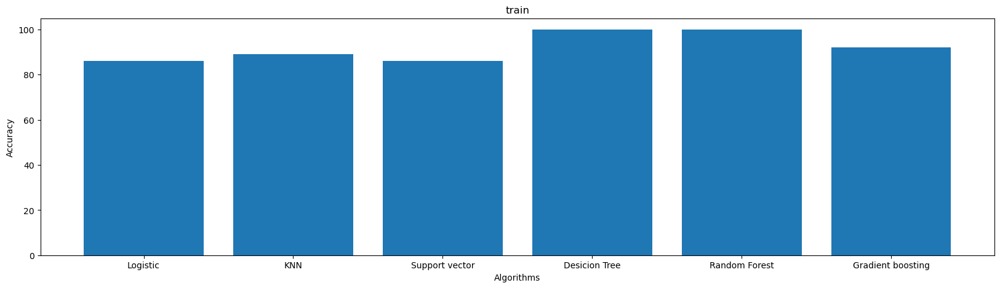

In [457]:
plt.figure(figsize=(20,5))
plt.bar(x,y)
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('train')

In [458]:
# for test data
x=['Logistic','KNN','Support vector','Desicion Tree','Random Forest','Gradient boosting']
y = [86,86,86,100,100,95]

Text(0.5, 1.0, 'Test data')

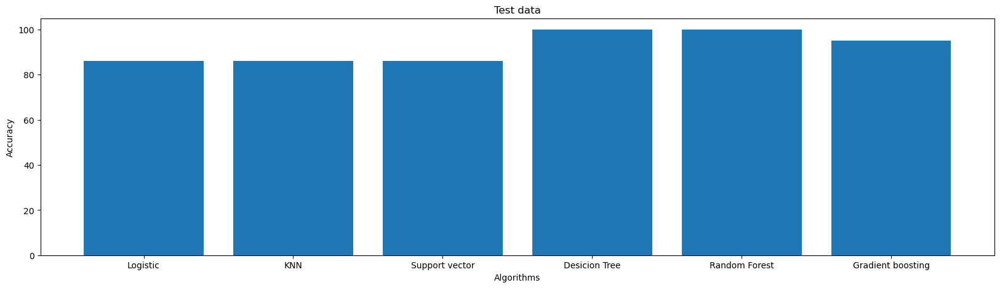

In [459]:
plt.figure(figsize=(20,5))
plt.bar(x,y)
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Test data')

In [460]:
# for SMOTE
x=['Logistic','KNN','Support vector','Desicion Tree','Random Forest','Gradient boosting']
y = [50,75,65,75,86,86]

Text(0.5, 1.0, 'SMOTE')

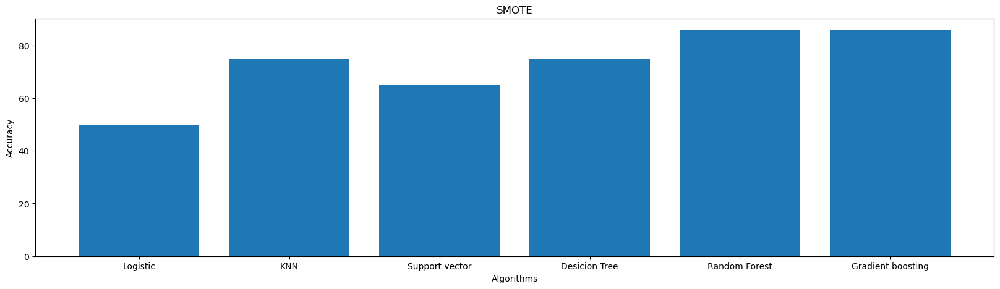

In [461]:
plt.figure(figsize=(20,5))
plt.bar(x,y)
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('SMOTE')

- Out of the the three observations Random Forest performs the best

#### Visualising the accuracy of algorithms with hyperparameters

In [463]:
#for train data
x_hyper=['Support vector','Descision tree','Random Forest','Gradient boosting']
y_hyper=[86,91,90,92]

Text(0.5, 1.0, 'Train(hyperparameter)')

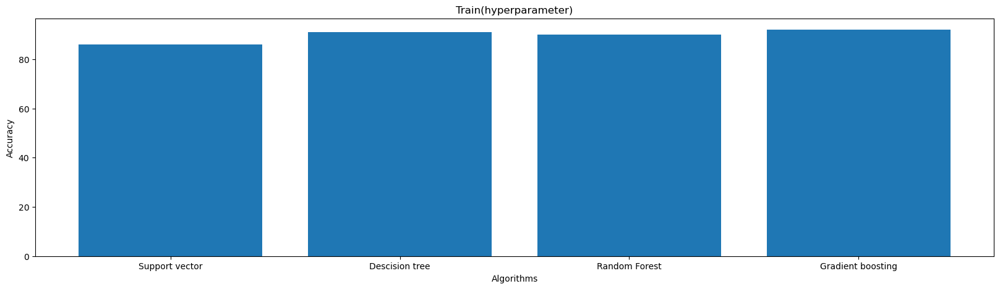

In [464]:
plt.figure(figsize=(20,5))
plt.bar(x_hyper,y_hyper)
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Train(hyperparameter)')

In [465]:
#for test data
x_hyper_test=['Support vector','Descision tree','Random Forest','Gradient boosting']
y_hyper_test=[86,86,100,95]

Text(0.5, 1.0, 'Test(hyperparameter)')

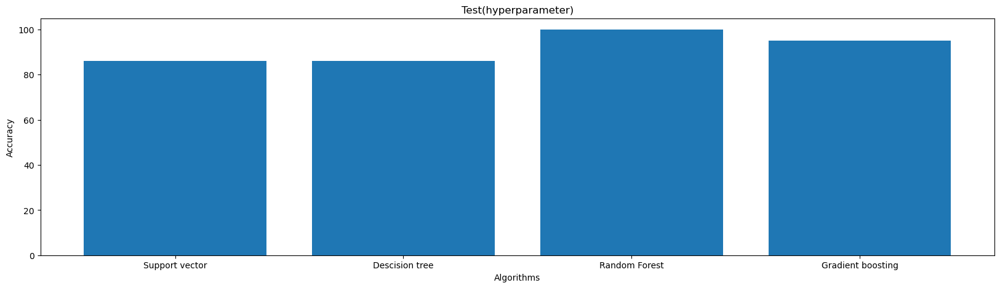

In [466]:
plt.figure(figsize=(20,5))
plt.bar(x_hyper_test,y_hyper_test)
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('Test(hyperparameter)')

In [467]:
# for SMOTE data
x_hyper_smote=['Support vector','Descision tree','Random Forest','Gradient boosting']
y_hyper_smote=[15,86,87,86]

Text(0.5, 1.0, 'SMOTE(hyperparameter)')

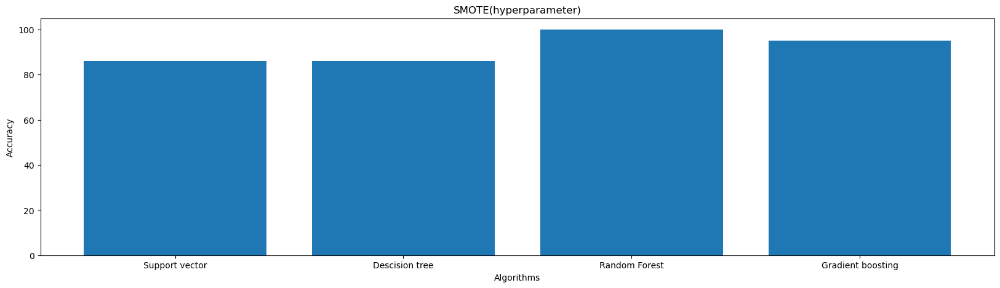

In [468]:
plt.figure(figsize=(20,5))
plt.bar(x_hyper_test,y_hyper_test)
plt.xlabel('Algorithms')
plt.ylabel('Accuracy')
plt.title('SMOTE(hyperparameter)')

## Conclusion

- Out of all the Observations we conclude that Random Forest Algorithm is best algorithm for this dataset